# Fun with FPNs (Feature Pyramid Networks)


![https://arxiv.org/abs/1612.03144](https://vitalab.github.io/deep-learning/images/fpn/architecture.png)

https://arxiv.org/abs/1612.03144

Our goal is to leverage a ConvNet’s pyramidal feature
hierarchy, which has semantics from low to high levels, and
build a feature pyramid with high-level semantics throughout.
The resulting Feature Pyramid Network is generalpurpose
and in this paper we focus on sliding window proposers
(Region Proposal Network, RPN for short) [29] and
region-based detectors (Fast R-CNN) [11]. We also generalize
FPNs to instance segmentation proposals in Sec. 6.

Our method takes a single-scale image of an arbitrary
size as input, and outputs proportionally sized feature maps
at multiple levels, in a fully convolutional fashion. This process
is independent of the backbone convolutional architectures
(e.g., [19, 36, 16]), and in this paper we present results
using ResNets [16]. The construction of our pyramid involves
a bottom-up pathway, a top-down pathway, and lateral
connections, as introduced in the following.

**Bottom-up pathway.** The bottom-up pathway is the feedforward
computation of the backbone ConvNet, which computes
a feature hierarchy consisting of feature maps at several
scales with a scaling step of 2. There are often many
layers producing output maps of the same size and we say
these layers are in the same network stage. For our feature
pyramid, we define one pyramid level for each stage. We
choose the output of the last layer of each stage as our reference
set of feature maps, which we will enrich to create
our pyramid. This choice is natural since the deepest layer
of each stage should have the strongest features.
Specifically, for ResNets [16] we use the feature activations
output by each stage’s last residual block. We denote
the output of these last residual blocks as {C2, C3, C4, C5}
for conv2, conv3, conv4, and conv5 outputs, and note that
they have strides of {4, 8, 16, 32} pixels with respect to the
input image. We do not include conv1 into the pyramid due
to its large memory footprint.

**Top-down pathway and lateral connections.** The topdown
pathway hallucinates higher resolution features by
upsampling spatially coarser, but semantically stronger, feature
maps from higher pyramid levels. These features are
then enhanced with features from the bottom-up pathway
via lateral connections. Each lateral connection merges feature
maps of the same spatial size from the bottom-up pathway
and the top-down pathway. The bottom-up feature map
is of lower-level semantics, but its activations are more accurately
localized as it was subsampled fewer times.
Fig. 3 shows the building block that constructs our topdown
feature maps. With a coarser-resolution feature map,
we upsample the spatial resolution by a factor of 2 (using
nearest neighbor upsampling for simplicity). The upsampled map is then merged with the corresponding bottom-up
map (which undergoes a 1×1 convolutional layer to reduce
channel dimensions) by element-wise addition. This process
is iterated until the finest resolution map is generated.
To start the iteration, we simply attach a 1×1 convolutional
layer on C5 to produce the coarsest resolution map. Finally,
we append a 3×3 convolution on each merged map to
generate the final feature map, which is to reduce the aliasing
effect of upsampling. This final set of feature maps is
called {P2, P3, P4, P5}, corresponding to {C2, C3, C4, C5}
that are respectively of the same spatial sizes.

Because all levels of the pyramid use shared classifiers/regressors
as in a traditional featurized image pyramid,
we fix the feature dimension (numbers of channels, denoted
as d) in all the feature maps. We set d = 256 in this paper
and thus all extra convolutional layers have 256-channel
outputs. There are no non-linearities in these extra layers,
which we have empirically found to have minor impacts.

Simplicity is central to our design and we have found that
our model is robust to many design choices. We have experimented
with more sophisticated blocks (e.g., using multilayer
residual blocks [16] as the connections) and observed
marginally better results. Designing better connection modules
is not the focus of this paper, so we opt for the simple
design described above.

In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
from fastai.conv_learner import *
from fastai.dataset import *

from pathlib import Path
import json
from PIL import ImageDraw, ImageFont
from matplotlib import patches, patheffects
from ipywidgets import FloatProgress
from IPython.display import display

import time

Setup

In [3]:
# dave's paths:
PATH = Path('data/pascal')
JPEGS = 'VOC2007/JPEGImages'

In [4]:
#PATH = Path('../data/pascal')
#JPEGS = 'VOCdevkit/VOC2007/JPEGImages'

In [5]:
trn_json = json.load((PATH/'pascal_train2007.json').open())
cats = {o['id']:o['name'] for o in trn_json['categories']}
imgs_fn = {o['id']:o['file_name'] for o in trn_json['images']}
imgs_id = [o['id'] for o in trn_json['images']]

In [6]:
trn_anno = collections.defaultdict(lambda:[])
for annot in trn_json['annotations']:
    if annot['ignore'] == 0:
        bb = annot['bbox']
        #Transforms bb which is left,top, width, height into top, left, bottom, right.
        bb = [bb[1],bb[0],bb[1] + bb[3], bb[0]+bb[2]]
        trn_anno[annot[('image_id')]].append((bb, annot['category_id']))
len(trn_anno)

2501

In [7]:
CLAS_CSV = PATH/'tmp/clas.csv'
MBB_CSV = PATH/'tmp/mbb.csv'

f_model=resnet34
size=224
batch_size=32

In [8]:
annot_cats = [[cats[int(ann[1])] for ann in trn_anno[i]] for i in imgs_id]
id2cats = list(cats.values())
cats2id = {c:i for i,c in enumerate(id2cats)}
model_cats = np.array([np.array([cats2id[c] for c in ac]) for ac in annot_cats])
model_cats

array([array([6]), array([14, 12]), array([ 1,  1, 14, 14, 14]), ..., array([17,  8, 14, 14, 14]),
       array([6]), array([11])], dtype=object)

In [9]:
val_idx = get_cv_idxs(len(imgs_id))
((val_cats, trn_cats),) = split_by_idx(val_idx, model_cats)

Bboxes

In [10]:
model_bbs = [np.concatenate([ann[0] for ann in trn_anno[i]]) for i in imgs_id]
model_bbsc = [' '.join([str(p) for p in o]) for o in model_bbs]

In [11]:
df = pd.DataFrame({'fn': [imgs_fn[i] for i in imgs_id], 'bbs': model_bbsc},columns=['fn','bbs'])

In [12]:
df.to_csv(MBB_CSV, index=False)

In [13]:
aug_tfms = [RandomRotate(10, tfm_y = TfmType.COORD),
           RandomLighting(0.05,0.05, tfm_y = TfmType.COORD),
           RandomFlip(tfm_y = TfmType.COORD)]
tfms = tfms_from_model(f_model, size, aug_tfms=aug_tfms, crop_type=CropType.NO, tfm_y = TfmType.COORD)
md = ImageClassifierData.from_csv(PATH, JPEGS, MBB_CSV, tfms=tfms, continuous=True, num_workers=4, val_idxs=val_idx, bs=batch_size)

In [14]:
class ConcatLblDataset(Dataset):
    def __init__(self, ds, y2):
        self.ds,self.y2 = ds,y2
        self.sz = ds.sz
    def __len__(self): return len(self.ds)
    
    def __getitem__(self, i):
        x,y = self.ds[i]
        return (x, (y,self.y2[i]))

In [15]:
trn_ds2 = ConcatLblDataset(md.trn_ds, trn_cats)
val_ds2 = ConcatLblDataset(md.val_ds, val_cats)
md.trn_dl.dataset = trn_ds2
md.val_dl.dataset = val_ds2

In [16]:
def hw2corners(ctr, hw): return torch.cat([ctr-hw/2,ctr+hw/2], dim=1)

## Customize Anchors

In [378]:
anc_grids = [28,14,4,2,1]
# anc_grids = [4]
anc_zooms = [.7, 2**0, 2**(1/3), 2**(2/3)]
#anc_zooms = [1.]
anc_ratios = [(1.,1.), (.5,1.), (1.,.5)]
#anc_ratios = [(1.,1.)]
anchor_scales = [(anz*i,anz*j) for anz in anc_zooms for (i,j) in anc_ratios]
k = len(anchor_scales)
anc_offsets = [1/(o*2) for o in anc_grids]
anc_x = np.concatenate([np.tile(np.linspace(ao, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_y = np.concatenate([np.repeat(np.linspace(ao, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_ctrs = np.repeat(np.stack([anc_x,anc_y], axis=1), k, axis=0)
anc_sizes  =   np.concatenate([np.array([[o/ag,p/ag] for i in range(ag*ag) for o,p in anchor_scales])
               for ag in anc_grids])
grid_sizes = V(np.concatenate([np.array([ 1/ag       for i in range(ag*ag) for o,p in anchor_scales])
               for ag in anc_grids]), requires_grad=False).unsqueeze(1)
anchors = V(np.concatenate([anc_ctrs, anc_sizes], axis=1), requires_grad=False).float()
anchor_cnr = hw2corners(anchors[:,:2], anchors[:,2:])

In [379]:
len(anchors), k

(12012, 12)

# Loss function

In [380]:
def one_hot_embedding(labels, num_classes):
    return torch.eye(num_classes)[labels.data.cpu()]

class BCE_Loss(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.num_classes = num_classes
    
    def forward(self, preds, targets):
        t = one_hot_embedding(targets, self.num_classes+1)
        t = V(t[:,:-1].contiguous()) #bg class is predicted when none of the others go out.
        x = preds[:,:-1]
        w = self.get_weight(x,t)# for the last part
        return F.binary_cross_entropy_with_logits(x, t, w, size_average=False) / self.num_classes
    
    def get_weight(self,x,t):
        return None

class FocalLoss(BCE_Loss):
    def get_weight(self,x,t):
        alpha,gamma = 0.25,2.
        p = x.sigmoid()
        pt = p*t + (1-p)*(1-t)
        w = alpha*t + (1-alpha)*(1-t)
        return w * (1-pt).pow(gamma)

loss_f = FocalLoss(len(id2cats))

In [381]:
def intersection(box_a,box_b):
    min_xy = torch.max(box_a[:,None,:2],box_b[None,:,:2])
    max_xy = torch.min(box_a[:,None,2:],box_b[None,:,2:])
    inter = torch.clamp(max_xy-min_xy,min=0)
    return inter[:,:,0] * inter[:,:,1]

def get_size(box):
    return (box[:,2]-box[:,0]) * (box[:,3] - box[:,1])

def jaccard(box_a,box_b):
    inter = intersection(box_a,box_b)
    union = get_size(box_a).unsqueeze(1) + get_size(box_b).unsqueeze(0) - inter
    return inter/union

In [382]:
#Removes the zero padding in the target bbox/class
def get_y(bbox,clas):
    bbox = bbox.view(-1,4)/size
    bb_keep = ((bbox[:,2] - bbox[:,0])>0.).nonzero()[:,0]
    return bbox[bb_keep], clas[bb_keep]
    
def actn_to_bb(actn, anchors):
    actn_bbs = torch.tanh(actn)
    actn_ctrs = (actn_bbs[:,:2] * grid_sizes/2) + anchors[:,:2]
    actn_hw = (1 + actn_bbs[:,2:]/2) * anchors[:,2:]
    return hw2corners(actn_ctrs,actn_hw)

def map_to_ground_truth(overlaps, print_it=False):
    prior_overlap, prior_idx = overlaps.max(1)
    #if print_it: print(prior_overlap)
#     pdb.set_trace()
    gt_overlap, gt_idx = overlaps.max(0)
    gt_overlap[prior_idx] = 1.99
    for i,o in enumerate(prior_idx): gt_idx[o] = i
    return gt_overlap,gt_idx

def ssd_1_loss(b_c,b_bb,bbox,clas,print_it=False, use_ab=True):
    bbox,clas = get_y(bbox,clas)
    a_ic = actn_to_bb(b_bb, anchors)
    overlaps = jaccard(bbox.data, (anchor_cnr if use_ab else a_ic).data)
    gt_overlap,gt_idx = map_to_ground_truth(overlaps,print_it)
    gt_clas = clas[gt_idx]
    pos = gt_overlap > 0.4
    pos_idx = torch.nonzero(pos)[:,0]
    gt_clas[1-pos] = len(id2cats)
    gt_bbox = bbox[gt_idx]
    loc_loss = ((a_ic[pos_idx] - gt_bbox[pos_idx]).abs()).mean()
    clas_loss  = loss_f(b_c, gt_clas)
    return loc_loss, clas_loss

def ssd_loss(pred,targ,print_it=False):
    lcs,lls = 0.,0.
    for b_c,b_bb,bbox,clas in zip(*pred,*targ):
        loc_loss,clas_loss = ssd_1_loss(b_c,b_bb,bbox,clas,print_it)
        lls += loc_loss
        lcs += clas_loss
    if print_it: print(f'loc: {lls.data[0]}, clas: {lcs.data[0]}')
    return lls+lcs

# Customize model

** some functions & good ideas from: ** https://github.com/sgugger/Deep-Learning/blob/master/Retina%20net%20Pascal.ipynb

In [383]:
class StdConv(nn.Module):
    def __init__(self, n_in,n_out,stride=2,dp = 0.1):
        super().__init__()
        self.conv = nn.Conv2d(n_in,n_out,3,stride=stride,padding=1)
        self.bn = nn.BatchNorm2d(n_out)
        self.dropout = nn.Dropout(dp)
        
    def forward(self,x):
        return self.dropout(self.bn(F.relu(self.conv(x))))
    
def flatten_conv(x,k):
    bs,nf,gx,gy = x.size()
    x = x.permute(0,2,3,1).contiguous()
    return x.view(bs,-1,nf//k) 

In [384]:
class OutConv(nn.Module):
    def __init__(self, k, n_in, bias):
        super().__init__()
        self.k = k
        self.oconv1 = nn.Conv2d(n_in, (len(id2cats)+1) * k, 3, padding=1)
        self.oconv2 = nn.Conv2d(n_in, 4 * k, 3, padding = 1)
        self.oconv1.bias.data.zero_().add_(bias)
        
    def forward(self,x):
        return [flatten_conv(self.oconv1(x), self.k),
                flatten_conv(self.oconv2(x), self.k)]

In [385]:
class SaveFeatures():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output
    def remove(self): self.hook.remove()

In [386]:
cut,lr_cut = model_meta[f_model]
def get_base():
    layers = cut_model(f_model(True), cut)
    return nn.Sequential(*layers)

In [387]:
# 2nd implementation
# anchor scales: 28, 14, 4, 2, 1

drop = 0.4

class SSD_Custom_2(nn.Module):
    def __init__(self, m_base, k, bias):
        super().__init__()
        self.m_base = m_base
        
        # bottom up 
        self.sfs = [SaveFeatures(m_base[i]) for i in [5,6]] # 28x28 & 14x14
        self.drop = nn.Dropout(drop)
        self.sconv1 = StdConv(512,256, dp=drop, stride=1) # 7x7
        self.sconv2 = StdConv(512,256, dp=drop) # 4x4
        self.sconv3 = StdConv(256,256, dp=drop) # 2x2
        self.sconv4 = StdConv(256,256, dp=drop) # 1x1
                  
        # lateral
        self.lat1 = nn.Conv2d(128,256, kernel_size=1, stride=1, padding=0)
        self.lat2 = nn.Conv2d(256,256, kernel_size=1, stride=1, padding=0)
        self.lat3 = nn.Conv2d(512,256, kernel_size=1, stride=1, padding=0)
        self.lat4 = nn.Conv2d(256,256, kernel_size=1, stride=1, padding=0)
        self.lat5 = nn.Conv2d(256,256, kernel_size=1, stride=1, padding=0)
        self.lat6 = nn.Conv2d(256,256, kernel_size=1, stride=1, padding=0)
       
        # outconvs
        self.out1 = OutConv(k, 256, bias)
        self.out2 = OutConv(k, 256, bias)
        self.out3 = OutConv(k, 256, bias)
        self.out4 = OutConv(k, 256, bias)
        self.out5 = OutConv(k, 256, bias)
        self.out6 = OutConv(k, 256, bias)
        
    def forward(self, x):
#         pdb.set_trace()
        x = self.drop(F.relu(self.m_base(x))) 
        
        c1 = self.sfs[0].features # 128, 28, 28
        c2 = self.sfs[1].features # 256, 14, 14     
        c3 = self.lat3(x)         # 512, 7, 7
        c4 = self.sconv2(x)       # 256, 4, 4
        c5 = self.sconv3(c4)      # 256, 2, 2
        c6 = self.sconv4(c5)      # 256, 1, 1
 
        p6 = self.lat6(c6)
        p5 = self._upsample_add(c6,self.lat5(c5))
        p4 = self._upsample_add(c5,self.lat4(c4))
#        p3 = self._upsample_add(c4,c3) # can't do nearest interpol from 4x4 to 7x7
        p2 = self._upsample_add(c3,self.lat2(c2))
        p1 = self._upsample_add(c2,self.lat1(c1))
        
        o1c,o1l = self.out1(p1)
        o2c,o2l = self.out2(p2)
#        o3c,o3l = self.out3(p3)
        o4c,o4l = self.out4(p4)
        o5c,o5l = self.out5(p5)
        o6c,o6l = self.out6(p6)
        
        return [torch.cat([o1c,o2c,o4c,o5c,o6c], dim=1),
                torch.cat([o1l,o2l,o4l,o5l,o6l], dim=1)]
    
    def _upsample_add(self, x, y):
        _,_,H,W = y.size()
        return F.upsample(x, size=(H,W), mode='nearest') + y

In [389]:
class MakeModel():
    def __init__(self,model,name='makemodel'):
        self.model,self.name = model,name

    def get_layer_groups(self, precompute):
        lgs = list(split_by_idxs(children(self.model.m_base), [lr_cut]))
        return lgs + [children(self.model)[1:]]

In [390]:
m_base = get_base()
m = to_gpu(SSD_Custom_2(m_base,k,-4))
models = MakeModel(m)
learn = ConvLearner(md, models)
learn.opt_fn = optim.Adam
learn.crit = ssd_loss

In [391]:
learn.summary()

OrderedDict([('Conv2d-1',
              OrderedDict([('input_shape', [-1, 3, 224, 224]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('trainable', False),
                           ('nb_params', 9408)])),
             ('BatchNorm2d-2',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('trainable', False),
                           ('nb_params', 128)])),
             ('ReLU-3',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('nb_params', 0)])),
             ('MaxPool2d-4',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 56, 56]),
                           ('nb_params', 0)])),
             ('Conv2d-5',
              OrderedDict([('input_shape', [-1, 64, 56, 

# NMS

In [392]:
def nms(boxes, scores, overlap=0.5, top_k=100):
    keep = scores.new(scores.size(0)).zero_().long()
    if boxes.numel() == 0: return keep
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]
    area = torch.mul(x2 - x1, y2 - y1)
    v, idx = scores.sort(0)  # sort in ascending order
    idx = idx[-top_k:]  # indices of the top-k largest vals
    xx1 = boxes.new()
    yy1 = boxes.new()
    xx2 = boxes.new()
    yy2 = boxes.new()
    w = boxes.new()
    h = boxes.new()

    count = 0
    while idx.numel() > 0:
        i = idx[-1]  # index of current largest val
        keep[count] = i
        count += 1
        if idx.size(0) == 1: break
        idx = idx[:-1]  # remove kept element from view
        # load bboxes of next highest vals
        torch.index_select(x1, 0, idx, out=xx1)
        torch.index_select(y1, 0, idx, out=yy1)
        torch.index_select(x2, 0, idx, out=xx2)
        torch.index_select(y2, 0, idx, out=yy2)
        # store element-wise max with next highest score
        xx1 = torch.clamp(xx1, min=x1[i])
        yy1 = torch.clamp(yy1, min=y1[i])
        xx2 = torch.clamp(xx2, max=x2[i])
        yy2 = torch.clamp(yy2, max=y2[i])
        w.resize_as_(xx2)
        h.resize_as_(yy2)
        w = xx2 - xx1
        h = yy2 - yy1
        # check sizes of xx1 and xx2.. after each iteration
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
        inter = w*h
        # IoU = i / (area(a) + area(b) - i)
        rem_areas = torch.index_select(area, 0, idx)  # load remaining areas)
        union = (rem_areas - inter) + area[i]
        IoU = inter/union  # store result in iou
        # keep only elements with an IoU <= overlap
        idx = idx[IoU.le(overlap)]
    return keep, count

# Plots

In [393]:
import matplotlib.cm as cmx
import matplotlib.colors as mcolors

def get_cmap(N):
    color_norm  = mcolors.Normalize(vmin=0, vmax=N-1)
    return cmx.ScalarMappable(norm=color_norm, cmap='Set3').to_rgba

num_colr = 12
cmap = get_cmap(num_colr)
colr_list = [cmap(float(x)) for x in range(num_colr)]

In [394]:
def bb_to_hw(bb):
    return [bb[1],bb[0],bb[3]-bb[1], bb[2]-bb[0]]

def show_img(im, figsize=None, axis=None):
    if not axis:
        fig,axis = plt.subplots(figsize=figsize)
    axis.imshow(im)
    axis.get_xaxis().set_visible(False)
    axis.get_yaxis().set_visible(False)
    return axis

def draw_outline(obj,lw):
    obj.set_path_effects([patheffects.Stroke(linewidth=lw, foreground='black'), patheffects.Normal()])
    
def draw_rect(axis, box, color='white'):
    patch = axis.add_patch(patches.Rectangle(box[:2],box[-2],box[-1],fill=False,edgecolor=color,lw=2))
    draw_outline(patch,4)
    
def draw_text(axis,xy,text,text_size=14, color='white'):
    patch = axis.text(*xy, text, verticalalignment='top', color=color, fontsize=text_size, weight='bold')
    draw_outline(patch,1)
    
def show_img_all(id_img):
    img = open_image(IMG_PATH/imgs_fn[id_img])
    axis = show_img(img, figsize=(16,8))
    for bbox, id_cat in trn_anno[id_img]:
        new_box = bb_to_hw(bbox)
        draw_rect(axis, new_box)
        draw_text(axis, new_box[:2], cats[id_cat])
        
def show_ground_truth(ax, im, bbox, clas = None, prs = None, tresh = 0.3):
    bb = [bb_to_hw(o) for o in bbox.reshape(-1,4)]
    if clas is None: clas = [None] * len(bb)
    if prs is None: prs = [None] * len(bb)
    ax = show_img(im,axis=ax)
    for i, (b,c,pr) in enumerate(zip(bb,clas,prs)):
        if b[2] > 0 and (pr is None or pr > tresh):#Show the bow only if there is something to show
            draw_rect(ax, b, colr_list[i%num_colr])
            txt = f'{i}: '
            if c is not None: txt += ('bg' if c == len(id2cats) else id2cats[c])
            if pr is not None: txt += f'{pr:.2f}'
            draw_text(ax,b[:2],txt,color=colr_list[i%num_colr])
        
def torch_gt(ax, ima, bbox, clas, prs=None, thresh=0.4):
    return show_ground_truth(ax, ima, to_np((bbox*224).long()),
         to_np(clas), to_np(prs) if prs is not None else None, thresh)

# Train

In [395]:
x,y = next(iter(md.val_dl))
y = V(y)
batch = learn.model(V(x))
ssd_loss(batch,y,True)

loc: 3.464144706726074, clas: 22.799701690673828


Variable containing:
 26.2638
[torch.cuda.FloatTensor of size 1 (GPU 0)]

In [410]:
lyrs = learn[3:12]
lyrs

lyrs2 = learn[3:6]
lyrs2

[StdConv(
   (conv): Conv2d(512, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
   (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
   (dropout): Dropout(p=0.4)
 ), StdConv(
   (conv): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
   (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
   (dropout): Dropout(p=0.4)
 ), StdConv(
   (conv): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
   (bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
   (dropout): Dropout(p=0.4)
 )]

In [411]:
sfs = [SaveFeatures(o) for o in lyrs]
#sfs2 = [SaveFeatures(o) for o in learn[2:6]]
py = learn.model(V(x))
for o in sfs: o.remove()
#for p in sfs2: p.remove()

py = np.exp(to_np(py)[0])

In [412]:
[o.features.size() for o in sfs]

[torch.Size([32, 256, 4, 4]),
 torch.Size([32, 256, 2, 2]),
 torch.Size([32, 256, 1, 1]),
 torch.Size([32, 256, 28, 28]),
 torch.Size([32, 256, 14, 14]),
 torch.Size([32, 256, 7, 7]),
 torch.Size([32, 256, 4, 4]),
 torch.Size([32, 256, 2, 2]),
 torch.Size([32, 256, 1, 1])]

In [413]:
def get_layerfeatures(layer, idx, num_ch, rand=False):
    feats = []
    if rand: start = np.random.randint(0,64-num_ch)
    else: start = 0
    for ch in range(num_ch):
        ch = ch+start
        feats.append(layer.features[idx][ch])
    return feats

In [417]:
def show_savedfeatures(sfs,idx,num_ch, show_base=True):
    ima=md.val_ds.ds.denorm(x)[idx]
    layer_feats = []

    for i in range(len(sfs)):
        feats = get_layerfeatures(sfs[i],idx,num_ch)
        layer_feats.append(feats)
        print(sfs[i].features.size())
        fig, axes = plt.subplots(1,num_ch, figsize=(2*num_ch,2*num_ch//3))
        for j, ax in enumerate(axes.flat):#fig, axes = 
            alpha=1
            if show_base: alpha = 0.5; ax = show_img(ima, axis=ax)
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
            ax.imshow(cv2.resize(to_np(feats[j]),(224,224), interpolation=cv2.INTER_NEAREST), alpha=alpha, cmap='hot')
        plt.show()
    return ima, layer_feats

In [418]:
idx = 9
num_ch = 10

torch.Size([32, 256, 4, 4])


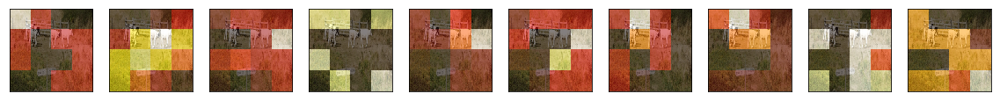

torch.Size([32, 256, 2, 2])


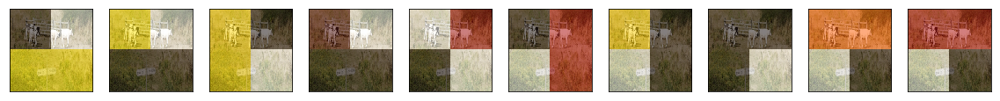

torch.Size([32, 256, 1, 1])


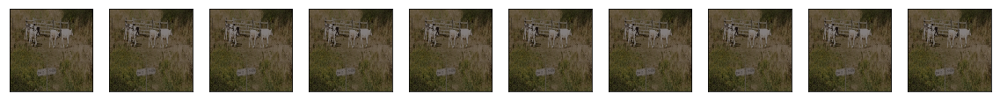

torch.Size([32, 256, 28, 28])


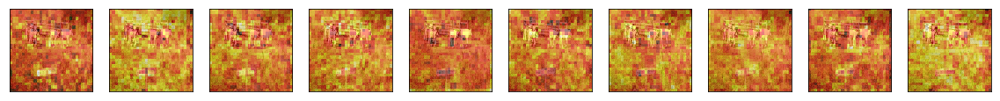

torch.Size([32, 256, 14, 14])


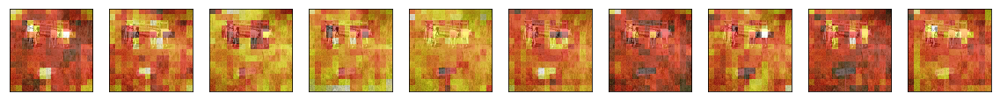

torch.Size([32, 256, 7, 7])


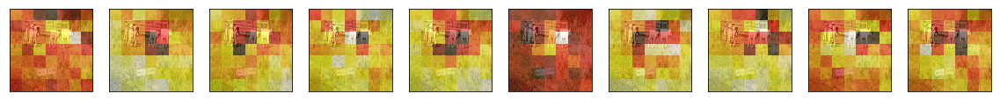

torch.Size([32, 256, 4, 4])


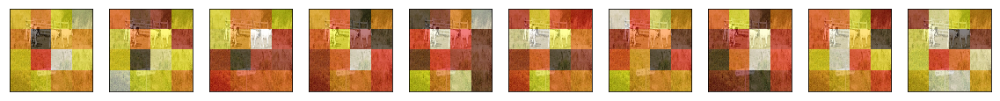

torch.Size([32, 256, 2, 2])


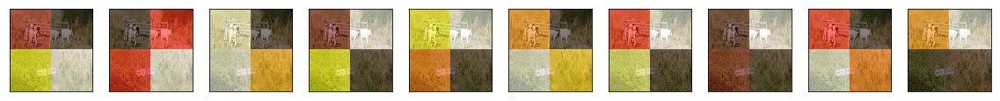

torch.Size([32, 256, 1, 1])


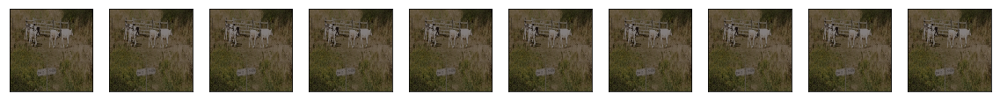

In [419]:
ima, feats = show_savedfeatures(sfs,idx,num_ch, True)

In [420]:
def resize_add(feat1, feat2, size):
    im1 = cv2.resize(to_np(feat1), size, interpolation=cv2.INTER_NEAREST)
    im2 = cv2.resize(to_np(feat2), size, interpolation=cv2.INTER_NEAREST)
    return im1+im2

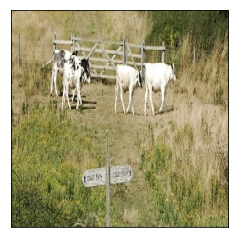

In [421]:
show_img(ima)

In [425]:
summed_feats = resize_add(feats[0][1], feats[1][1], ima.shape[:-1])

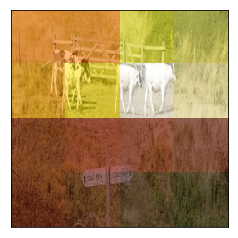

In [426]:
show_img(ima)
plt.imshow(summed_feats, alpha=0.5, cmap='hot')

In [427]:
lr = 1e-3
lrs = np.array([lr/100,lr/10,lr])

In [428]:
learn.lr_find(lr/100,lr*1000)

HBox(children=(IntProgress(value=0, description='Epoch', max=1), HTML(value='')))

 59%|█████▊    | 37/63 [00:16<00:11,  2.20it/s, loss=183] 

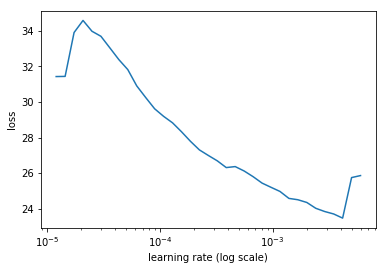

In [429]:
learn.sched.plot(1,1)

In [430]:
version_str='i_0414'

In [431]:
learn.fit(lrs, 1, cycle_len=5, use_clr=(20,10))

HBox(children=(IntProgress(value=0, description='Epoch', max=5), HTML(value='')))

 32%|███▏      | 20/63 [00:09<00:20,  2.13it/s, loss=22.7]


Exception in thread Thread-94:
Traceback (most recent call last):
  File "/home/paperspace/anaconda3/envs/fastai/lib/python3.6/threading.py", line 916, in _bootstrap_inner
    self.run()
  File "/home/paperspace/anaconda3/envs/fastai/lib/python3.6/site-packages/tqdm/_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "/home/paperspace/anaconda3/envs/fastai/lib/python3.6/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration



epoch      trn_loss   val_loss                            
    0      18.147287  13.737259 
    1      13.664924  11.405643                           
    2      11.902558  10.899733                           
    3      10.923902  10.338471                           
    4      10.137186  10.050476                           



[10.05047615814209]

In [432]:
learn.freeze_to(-1)
learn.fit(lrs/2,1, cycle_len=5, use_clr=(20,10))

HBox(children=(IntProgress(value=0, description='Epoch', max=5), HTML(value='')))

epoch      trn_loss   val_loss                            
    0      9.823138   10.311895 
    1      9.793821   10.089513                           
    2      9.399406   9.985791                            
    3      8.895549   9.678961                            
    4      8.644744   9.545633                            



[9.545632953643798]

In [433]:
learn.freeze_to(-2)
learn.fit(lrs/2,1, cycle_len=5, use_clr=(20,10))

HBox(children=(IntProgress(value=0, description='Epoch', max=5), HTML(value='')))

epoch      trn_loss   val_loss                            
    0      8.980369   9.932294  
    1      8.903566   9.511754                            
    2      8.446741   9.260639                            
    3      7.981649   9.158207                            
    4      7.677906   9.020468                            



[9.020467555999756]

In [434]:
learn.save(f'fpn_custom{version_str}_03')

In [435]:
learn.freeze_to(0)
learn.fit(lrs/4,1, cycle_len=5, use_clr=(20,10))

HBox(children=(IntProgress(value=0, description='Epoch', max=5), HTML(value='')))

epoch      trn_loss   val_loss                            
    0      7.661013   9.183778  
    1      7.524174   9.066604                            
    2      7.214864   9.020887                            
    3      7.068804   8.953654                            
    4      6.863917   8.921093                            



[8.921092922210693]

In [436]:
learn.save(f'fpn_custom14421{version_str}_04')

In [437]:
learn.freeze_to(0)
learn.fit(lrs/5,1, cycle_len=5, use_clr=(20,10))

HBox(children=(IntProgress(value=0, description='Epoch', max=5), HTML(value='')))

epoch      trn_loss   val_loss                            
    0      7.112735   9.094475  
    1      6.979589   8.915065                            
    2      6.764565   8.880578                            
    3      6.671404   8.874813                            
    4      6.493187   8.823926                            



[8.82392558670044]

In [438]:
learn.save(f'fpn_custom14421{version_str}_05')

# Load Model and set to eval

In [439]:
#learn.load('fpn_custom14421a_0412_04')
#learn.load('fpn_custom14421e_0411_05')
learn.model.eval()

SSD_Custom_2(
  (m_base): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), dilation=(1, 1), ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=

# Evaluate Model

In [440]:
x,y = next(iter(md.val_dl))
y = V(y)
batch = learn.model(V(x))
x = to_np(x)

In [441]:
ssd_loss(batch,y,True)

loc: 1.7882390022277832, clas: 6.824036121368408


Variable containing:
 8.6123
[torch.cuda.FloatTensor of size 1 (GPU 0)]

In [442]:
def get_pred(idx, x, y, batch, md_thres=0.35, display=False):

    b_clas, b_bb = batch
    bbox, clas = get_y(y[0][idx], y[1][idx])
    a_ic = actn_to_bb(b_bb[idx], anchors)

    conf_scores = b_clas[idx].sigmoid().t().data

    out1,out2,cc = [],[],[]
    for cl in range(0, len(conf_scores)-1):
        c_mask = conf_scores[cl] > md_thres
        if c_mask.sum() == 0: continue
        scores = conf_scores[cl][c_mask]
        l_mask = c_mask.unsqueeze(1).expand_as(a_ic)
        boxes = a_ic[l_mask].contiguous().view(-1, 4)
        ids, count = nms(boxes.data, scores, 0.4, 50)
        ids = ids[:count]
        
        out1.append(scores[ids])
        out2.append(boxes.data[ids])
        cc.append([cl]*count)
        
    # setting -1s to prevent an empty tensor error if no predictions > model_thres
    if not cc: cc = T([-1])
    else: cc = T(np.concatenate(cc)) 
    if not out1: out1 = T([[-1.,]])
    else: out1 = torch.cat(out1)
    if not out2: out2 = T([[-1., -1., -1., -1.]])
    else: out2 = torch.cat(out2)
        
    pr = (cc, out1, out2) # class, conf, bb
    gt = (clas.data, bbox.data) # class, bb
    
    if display:
        ima=md.val_ds.ds.denorm(x)[idx]
        show_img_3col(ima, pr, gt)
    
    return pr, gt 

In [443]:
def show_img_3col(ima, pr, gt):
    pr_cl, pr_conf, pr_bb = pr
    gt_cl = gt[0]
    gt_bb = gt[1]
    
    #ima=md.val_ds.ds.denorm(x)[idx]
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 45))
    torch_gt(ax1, ima, pr_bb, pr_cl, pr_conf, 0.)
    
    if to_np(pr_conf)[0] >= 0: str_obj = str(len(pr_conf)) 
    else: str_obj = '0'
    title1_str = '# detected: '+ str_obj
    ax1.text(0,-10,title1_str)

    torch_gt(ax2, ima, gt_bb, gt_cl, None, 0.)
    title2_str = '# GT objects: '+ str(len(gt_cl))
    ax2.text(0,-10,title2_str)

    show_img(ima, axis=ax3)
    ax3.grid(False)
    
    plt.show()

In [444]:
# count TP, FP, FN for a single image in a single class, assuming that class is in both prediction and ground truth

def tpfpfn_1img(conf_pr, bb_pr, bb_gt, thres):
    '''
    mostly borrowed from https://gist.github.com/tarlen5/008809c3decf19313de216b9208f3734 starting line 80
    ''' 
    
    # calc IoUs for every prediction to every gt object. If > threshold, add to idx counters
    pr_overthres_idx = []
    gt_overthres_idx = []
    #ious_overthres = [] # sort by confidence instead of IoU
    conf_overthres = []
    for i, pr in enumerate(bb_pr):
        for j, gt in enumerate(bb_gt):
            pr = T(pr).cpu()
            gt = T(gt).cpu()

            overlap = to_np(jaccard(gt.unsqueeze(0), pr.unsqueeze(0)))
            if overlap >= thres:
                #print(i, j, overlap)
                pr_overthres_idx.append(i)
                gt_overthres_idx.append(j)
                #ious_overthres.append(float(overlap))
                conf_overthres.append(conf_pr[i])
    
    # sort idx in order of highest confidence first, change from IoU sorting approach
    idxsorted = np.argsort(conf_overthres)[::-1]
    
    # for each match, check if already counted as detected or not. if not, add to idx counter
    gt_match_idx = []
    pr_match_idx = []
    for idx in idxsorted:
        gt_idx = gt_overthres_idx[idx]
        pr_idx = pr_overthres_idx[idx]
        #print(id_pred_overthres[idx], id_gt_overthres[idx])
        if pr_idx not in pr_match_idx and gt_idx not in gt_match_idx:
            gt_match_idx.append(gt_idx)
            pr_match_idx.append(pr_idx)

    tp = len(gt_match_idx)
    fp = len(bb_pr) - len(pr_match_idx)
    fn = len(bb_gt) - tp
    
    return tp, fp, fn

In [445]:
def oneclass_tpfpfn_1img(cat, idx, pr, gt, iou_thres):
    
    pr_cl, pr_conf, pr_bb = pr
    gt_cl = gt[0]
    gt_bb = gt[1]
    
    pr_cl = pr_cl.cpu()
    pr_conf = pr_conf.cpu()
    pr_bb = pr_bb.cpu()
    gt_cl = gt_cl.cpu()
    gt_bb = gt_bb.cpu()

    tp = 0
    fp = 0
    fn = 0
    
    if cat in pr_cl and cat in gt_cl:
        bb_gt = gt_bb[list(np.argwhere(cat == gt_cl))]
        bb_pr = pr_bb[list(np.argwhere(cat == pr_cl))]
        tp, fp, fn = tpfpfn_1img(pr_conf, bb_pr, bb_gt, iou_thres)
        
    elif cat in pr_cl and cat not in gt_cl: # every detection counts as a false pos
        fp = len(pr_bb[list(np.argwhere(cat == pr_cl))]) 
        
    elif cat not in pr_cl and cat in gt_cl: # every gt obj counts as a false neg
        fn = len(gt_cl[list(np.argwhere(cat == gt_cl))]) 
        
    gt_c = len(np.argwhere(to_np(gt[0])==cat))
    return tp,fp,fn,gt_c

In [446]:
def nclass_tpfnfn_1img(cats, idx, x,y,batch, md_thres=0.25, iou_thres=0.5, display=True, verbose=True):
    pr, gt = get_pred(idx,x,y,batch, md_thres, display)
    
    if verbose: print('TP FP FN GTc   Category')
        
    for cat in cats:
        cl_str = id2cats[cat]
        tp,fp,fn,gt_c = oneclass_tpfpfn_1img(cat, idx, pr, gt, iou_thres)
        
        if verbose: 
            if np.any([tp,fp,fn,gt_c]): print(f'{tp}  {fp}  {fn}  {gt_c}      {id2cats[cat]} (cat{cat})')  

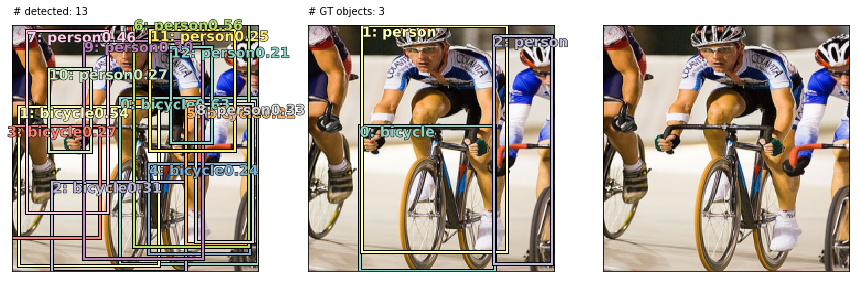

TP FP FN GTc   Category
1  5  0  1      bicycle (cat1)
2  5  0  2      person (cat14)


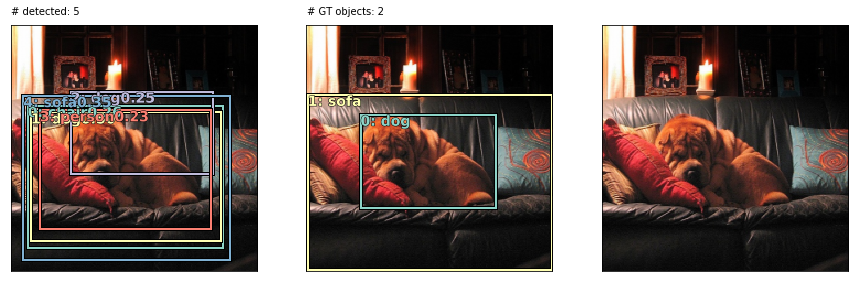

TP FP FN GTc   Category
0  1  0  0      chair (cat8)
1  1  0  1      dog (cat11)
0  1  0  0      person (cat14)
1  0  0  1      sofa (cat17)


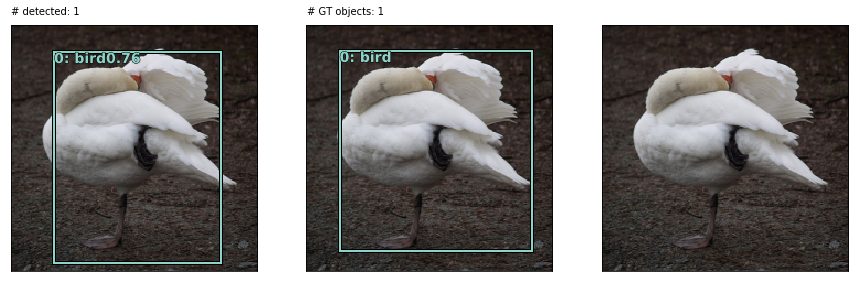

TP FP FN GTc   Category
1  0  0  1      bird (cat2)


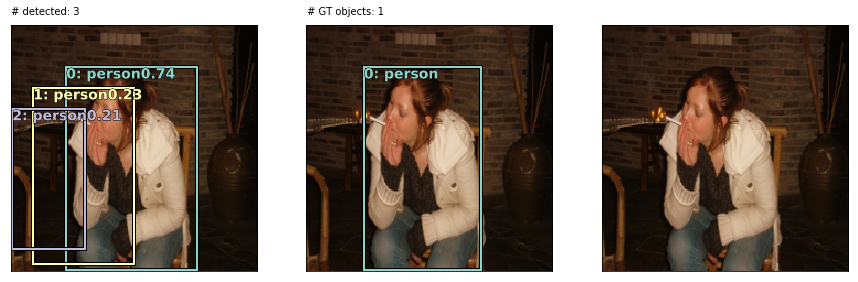

TP FP FN GTc   Category
1  2  0  1      person (cat14)


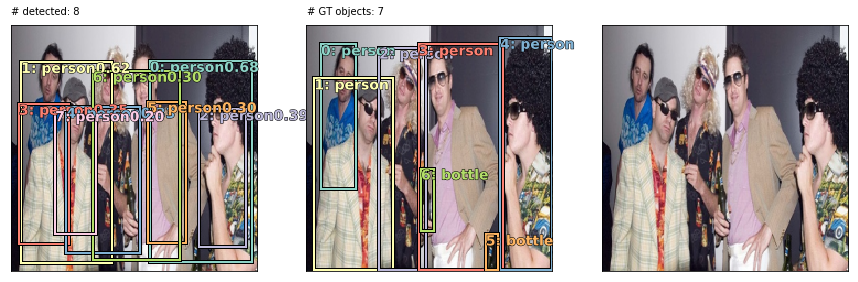

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  7  4  5      person (cat14)


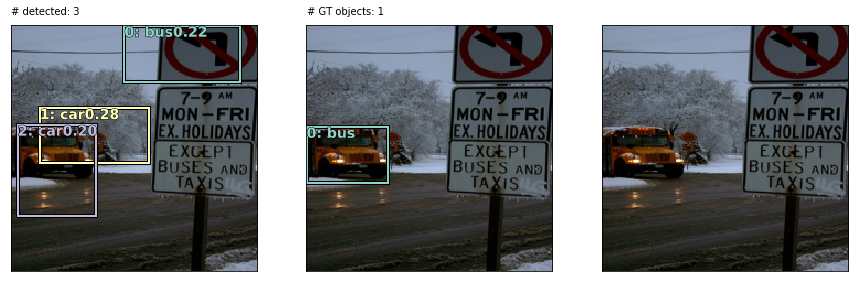

TP FP FN GTc   Category
0  1  1  1      bus (cat5)
0  2  0  0      car (cat6)


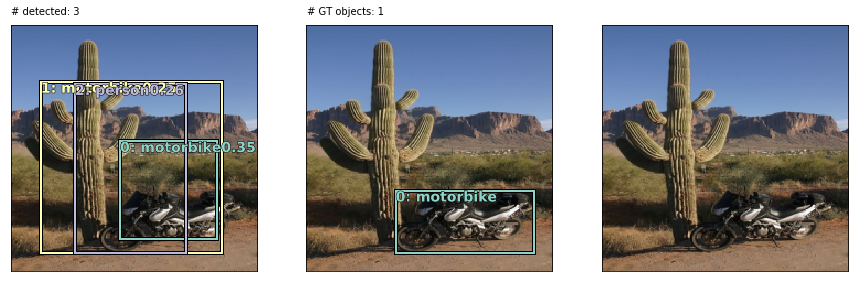

TP FP FN GTc   Category
0  2  1  1      motorbike (cat13)
0  1  0  0      person (cat14)


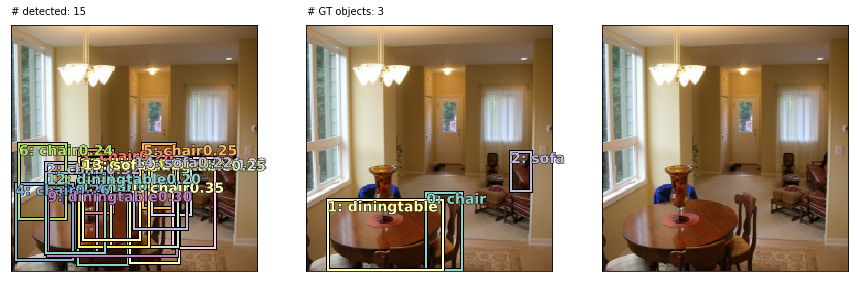

TP FP FN GTc   Category
1  8  0  1      chair (cat8)
1  3  0  1      diningtable (cat10)
0  2  1  1      sofa (cat17)


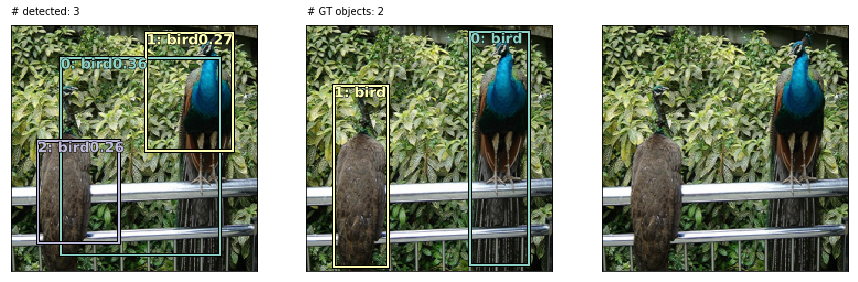

TP FP FN GTc   Category
0  3  2  2      bird (cat2)


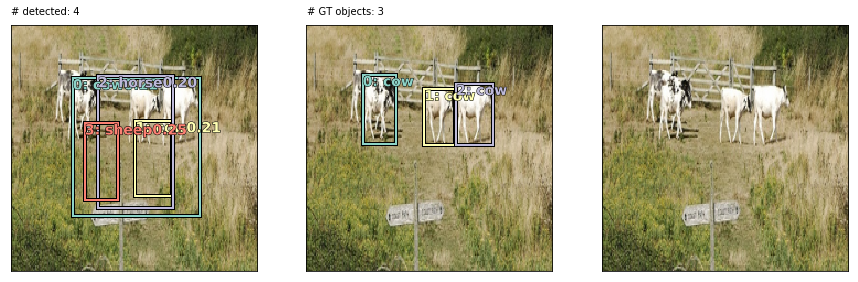

TP FP FN GTc   Category
0  2  3  3      cow (cat9)
0  1  0  0      horse (cat12)
0  1  0  0      sheep (cat16)


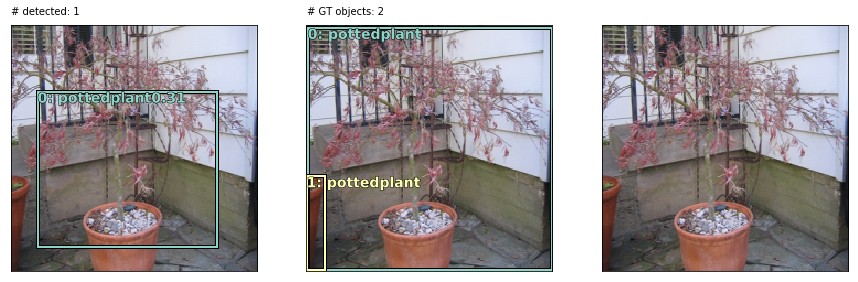

TP FP FN GTc   Category
0  1  2  2      pottedplant (cat15)


In [447]:
for idx in range(11):
    nclass_tpfnfn_1img(range(20), idx, x, y, batch, 0.2)

# Calculate all the things!

In [448]:
x,y = next(iter(md.val_dl))
y = V(y)
batch = learn.model(V(x))
b_clas,b_bb = batch
x = to_np(x)

In [449]:
def count(L):
    result = collections.defaultdict(int)
    if L is not None:
        for x in L:
            result[x] += 1
    return result

In [450]:
def all_tpfpfn(md_thres_rng, iou_thres, cats):

    start = time.time()

    tps = np.zeros((len(id2cats), len(md_thres_rng)))
    fps = np.zeros((len(id2cats), len(md_thres_rng)))
    fns = np.zeros((len(id2cats), len(md_thres_rng)))
    gt_c = np.zeros(len(id2cats))
    b_count = 0

    for data in md.val_dl:
        x,y = data
        y = V(y)
        batch = learn.model(V(x))
        b_clas,b_bb = batch
        #x = to_np(x)
        b_count +=1

        for idx in range(len(y[0])):     
            pr, gt = get_pred(idx, x, y, batch, np.min(md_thres_rng)) # get preds at min md_thres, mask later

            # mask for preds where conf > thres at each md_thres step. major speed up (40min -> 2min)
            # inspired by @sgugger nb cell 168: https://github.com/sgugger/Deep-Learning/blob/master/mAP/Computing%20the%20mAP%20metric.ipynb
            for i, md_thres in enumerate(md_thres_rng):
                if np.any(to_np(pr[1]) > md_thres): 
                    masked_idx = T(np.argwhere(to_np(pr[1]) > md_thres)).squeeze() 
                else: break

                pr_masked = (pr[0][masked_idx], pr[1][masked_idx], pr[2][masked_idx])

                for cat in cats:
                    tp,fp,_,_ = oneclass_tpfpfn_1img(cat, idx, pr_masked, gt, iou_thres)
                    tps[cat,i] += tp
                    fps[cat,i] += fp

            # calc FNs separately because pr masking and loop break above misses FNs at higher thresh where there are no predictions
            for cat in cats: gt_c[cat] += count(list(gt[0]))[cat]
            fns = np.repeat(np.expand_dims(gt_c, axis=1),n, axis=1) - tps

        print(f'finished with batch {b_count}')

    end = time.time(); print((end - start)/60)
    
    return tps, fps, fns

In [451]:
n = 40
md_thres_rng = np.linspace(.05, 0.95, n, endpoint=True)
iou_thres = 0.5
cats = range(len(id2cats))

tps1, fps1, fns1 = all_tpfpfn(md_thres_rng, iou_thres, cats)

finished with batch 1
finished with batch 2
finished with batch 3
finished with batch 4
finished with batch 5
finished with batch 6
finished with batch 7
finished with batch 8
finished with batch 9
finished with batch 10
finished with batch 11
finished with batch 12
finished with batch 13
finished with batch 14
finished with batch 15
finished with batch 16
0.9951222856839498


# AP@.5 (IoU > 0.50) per category 

In [452]:
def avg_prec(precisions, recalls):
    prec_at_rec = []
    for recall_level in np.linspace(0.0, 1.0, 11):
        try:
            args = np.argwhere(recalls >= recall_level).flatten()
            prec = max(precisions[args])
        except ValueError:
            prec = 0.0
        prec_at_rec.append(prec)
    return np.array(prec_at_rec).mean()

In [453]:
def calc_prec_reca(tps, fps, fns, cat):
    eps = np.spacing(1)
    precision = tps[cat,:] / (tps[cat,:]+fps[cat,:]+eps)
    recall = tps[cat,:] / (tps[cat,:]+fns[cat,:])
    ap = avg_prec(precision, recall)
    
    return ap, precision, recall

In [454]:
def draw_prcurves(tps, fps, fns):
    fig, axes = plt.subplots(5, 4, figsize=(24, 30))
    aps = []

    for i,ax in enumerate(axes.flat):  
        ap, precision, recall = calc_prec_reca(tps, fps, fns, i)
        aps.append(ap)
        ax.plot(recall, precision)
        ax.set_xlim(0,1.1)
        ax.set_ylim(0,1.1)
        ax.set_title(f'cat {i} {id2cats[i]}, AP: {ap:4.4f}')
        ax.set_xlabel('recall')
        ax.set_ylabel('precision')

    plt.tight_layout()
    
    return aps

# mAP@ 0.5 of 20 classes using 11-point interpolated average precision

0.28700402183840373

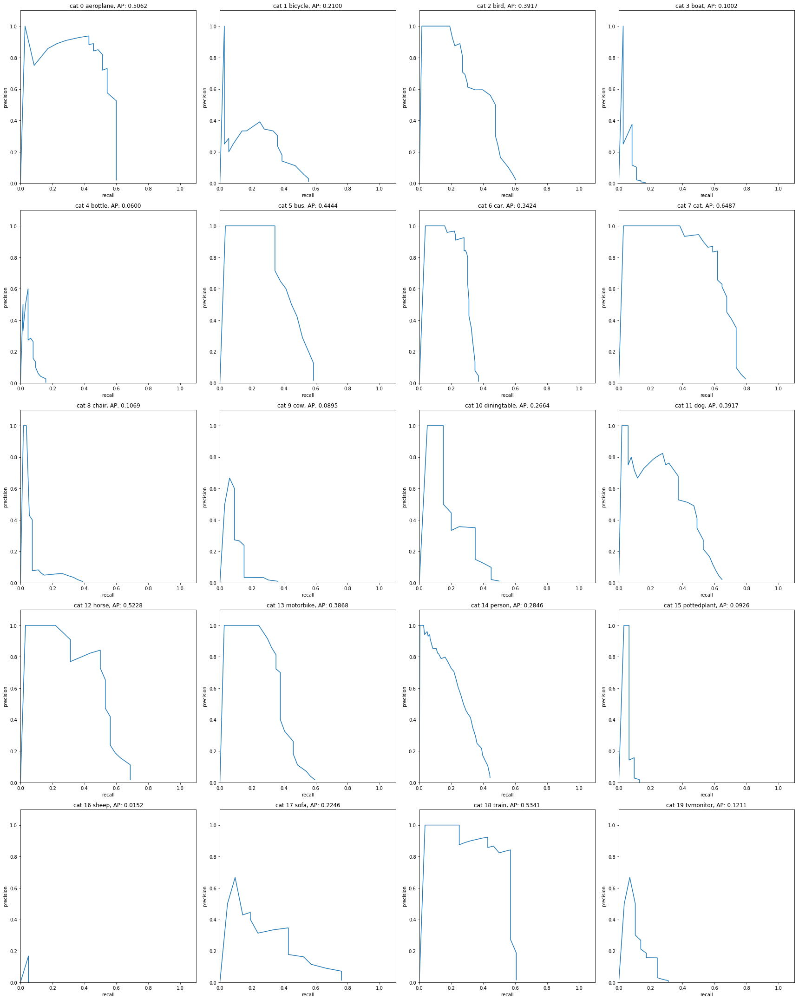

In [455]:
aps4 = draw_prcurves(tps1,fps1,fns1)
mAP = np.array(aps4).mean()
mAP

In [457]:
aps4

[0.506198347107438,
 0.21003208559891948,
 0.3917383346580427,
 0.10023310023310023,
 0.060031347962382436,
 0.44440559440559435,
 0.3424242424242424,
 0.6486971409005308,
 0.10690755498199281,
 0.08947094088545503,
 0.26639866940742213,
 0.39170868227094663,
 0.5227983409424843,
 0.3868104001343833,
 0.2846492734322006,
 0.09260042283298096,
 0.01515151515151515,
 0.22458450289904625,
 0.5340974814659026,
 0.12114245907349354]

In [458]:
def show_tpfp_class(fps,tps,cat,ylims):
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,5))

    #y2_max = fps1[0].max()
    ax1.set_xlim(0,1.)
    ax1.set_ylim(0,ylims[0])

    ax1.grid(1)
    ax2.grid(1)

    #ax2 = ax1.twinx()
    ax2.set_xlim(0,1.)
    ax2.set_ylim(0,ylims[1])

    ax1.plot(md_thres_rng, fps[cat], '.r-')
    ax2.plot(md_thres_rng, tps[cat], '.b-')
    #ax1.semilogy(fps[cat], np.exp(fps[cat]/1000))
    
    ax1.set_title(f'FPs for {id2cats[cat]}')
    ax1.set_xlabel('Model Confidence Threshold')

    ax2.set_title(f'TPs for {id2cats[cat]}')
    ax2.set_xlabel('Model Confidence Threshold')

    ax1.set_ylabel('FPs', color='r')
    ax2.set_ylabel('TPs', color='b')

    plt.tight_layout()


1008.0 21.0


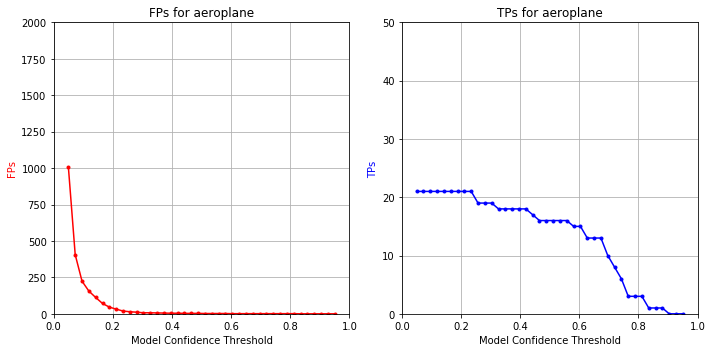

1761.0 20.0


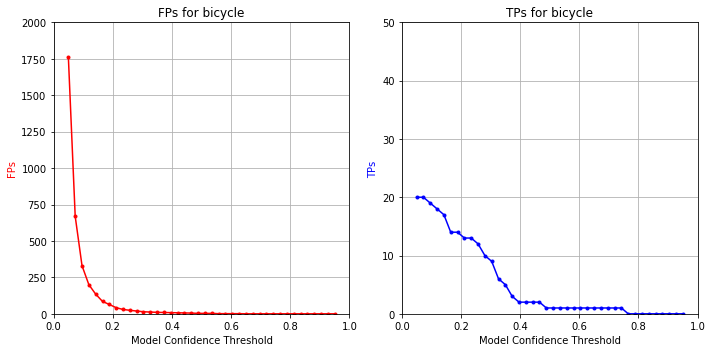

1606.0 38.0


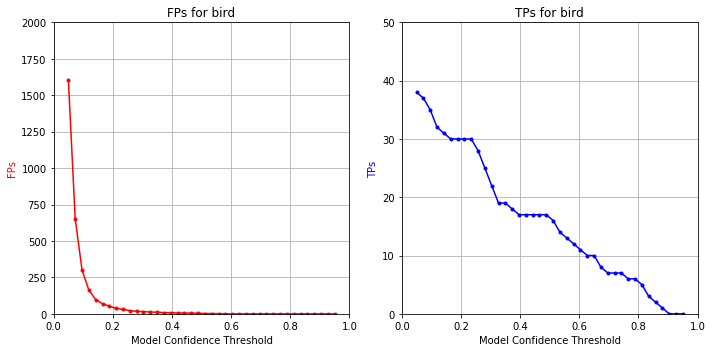

1447.0 6.0


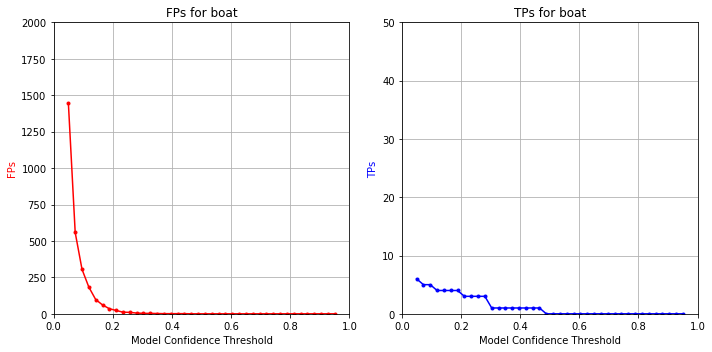

2152.0 10.0


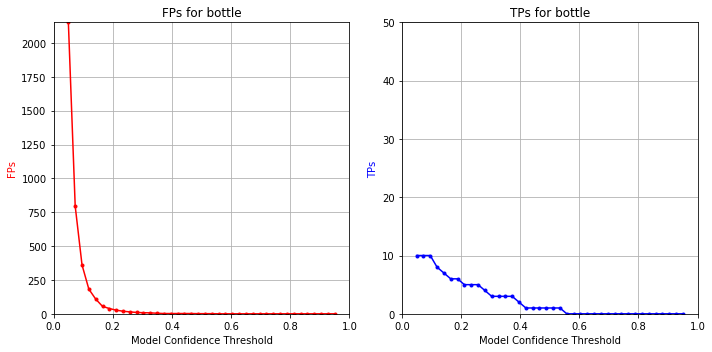

1001.0 17.0


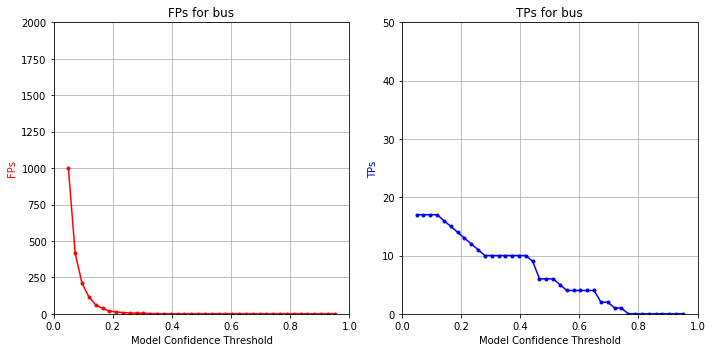

4647.0 49.0


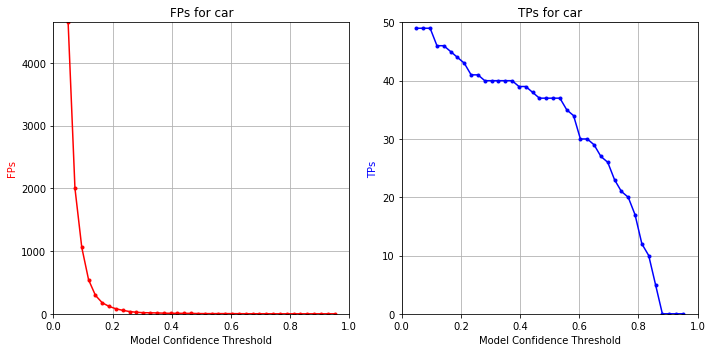

1018.0 27.0


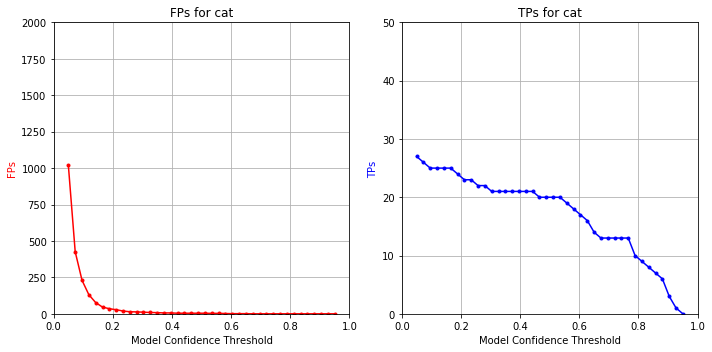

2515.0 21.0


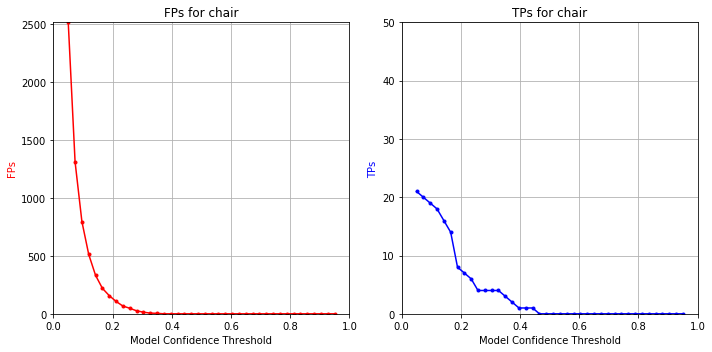

1224.0 12.0


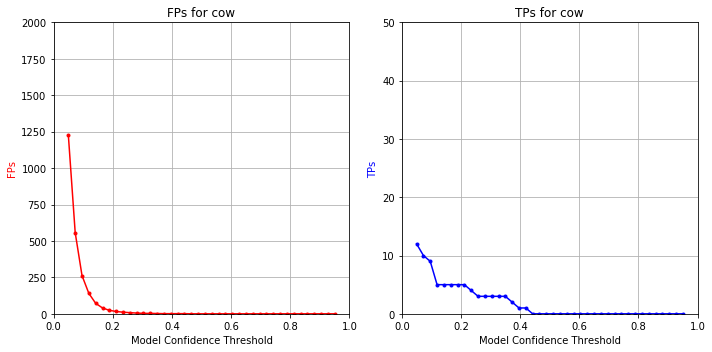

904.0 10.0


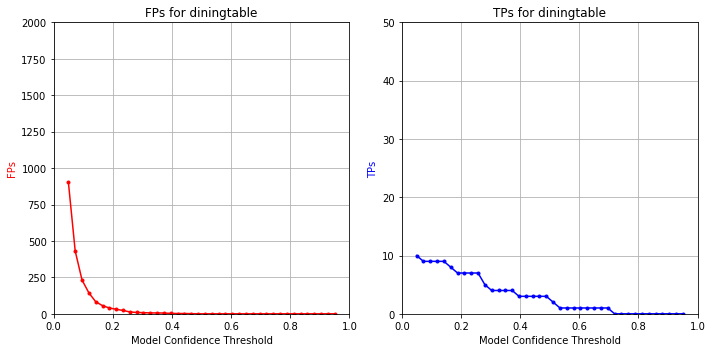

1593.0 33.0


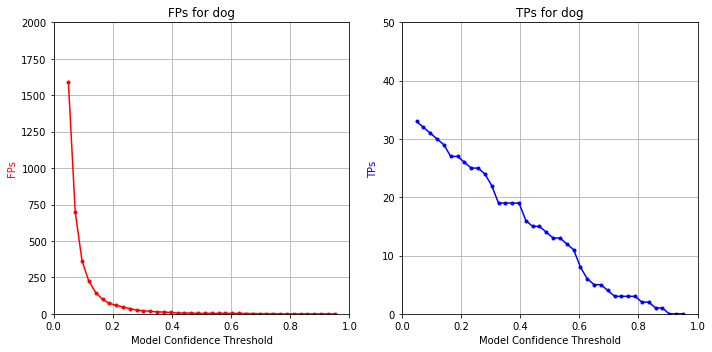

1215.0 22.0


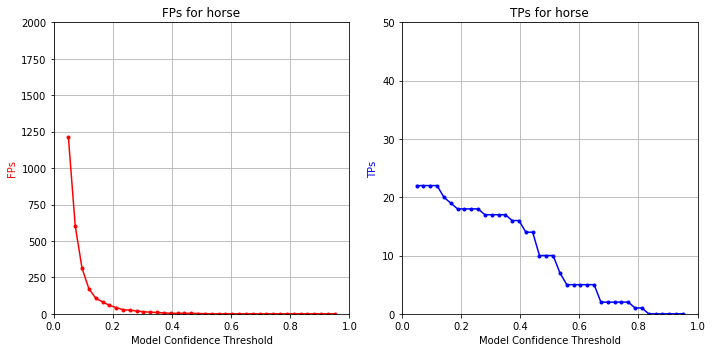

1222.0 22.0


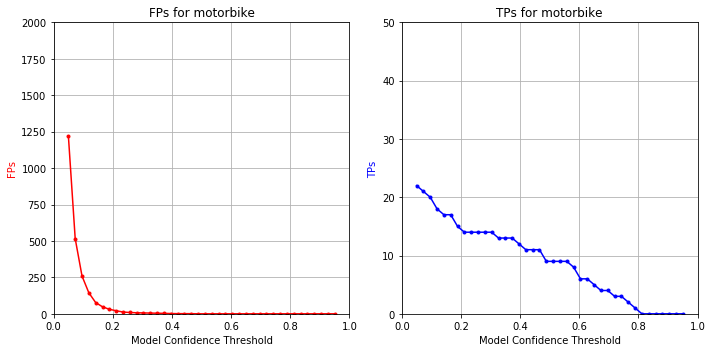

6726.0 217.0


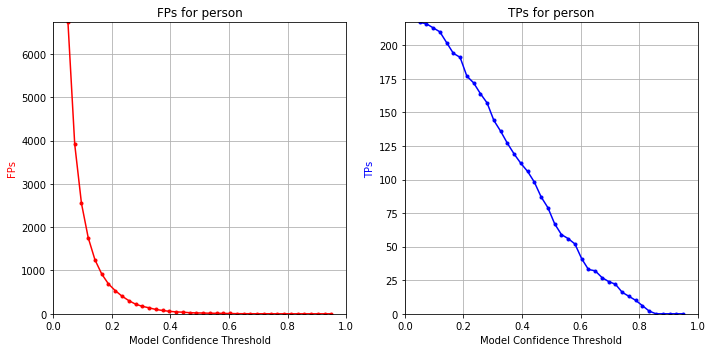

3050.0 4.0


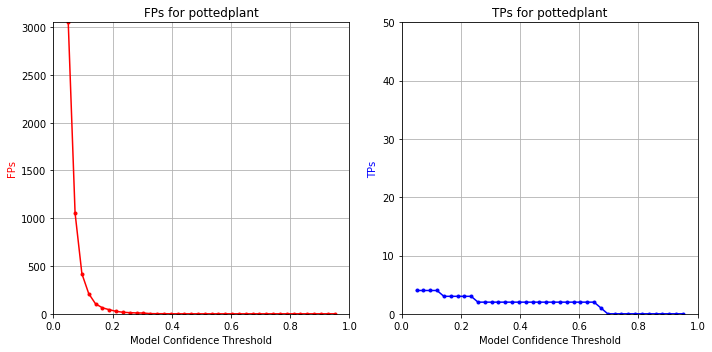

1305.0 1.0


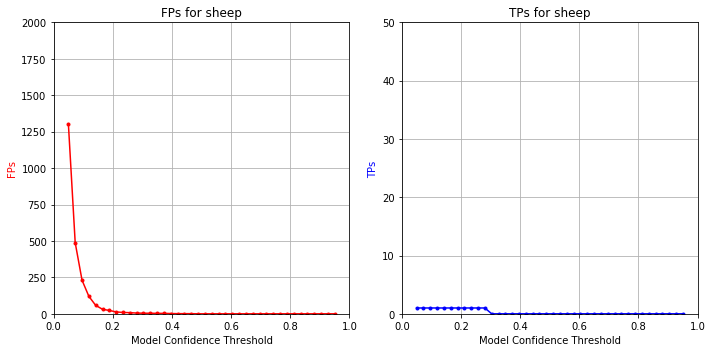

1216.0 16.0


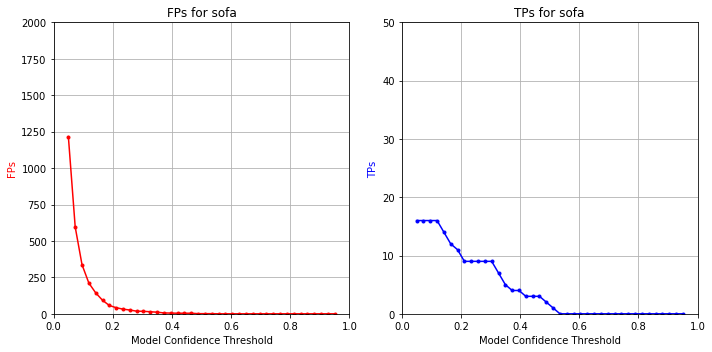

1105.0 17.0


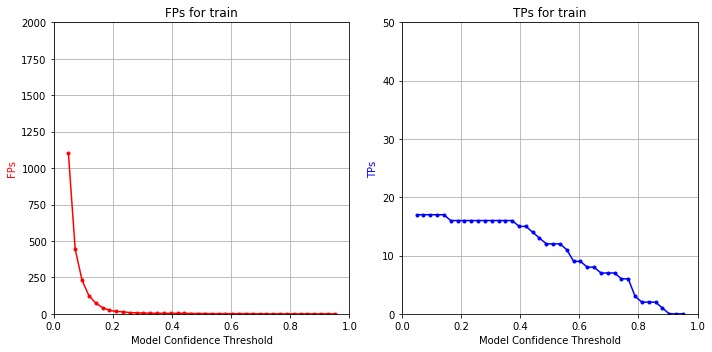

1993.0 9.0


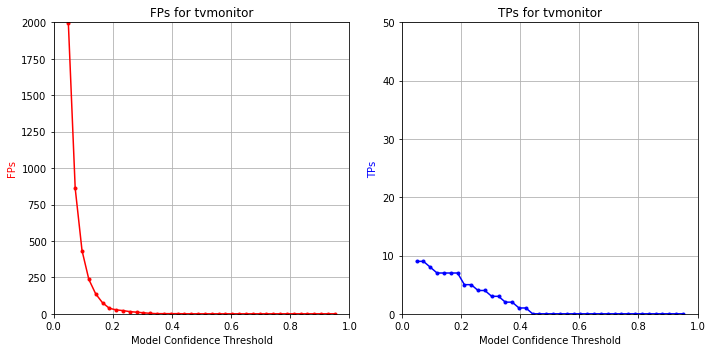

In [459]:
for cl in range(len(id2cats)):
    print(fps1[cl].max(), tps1[cl].max())
    show_tpfp_class(fps1,tps1,cl,(np.maximum(2000,fps1[cl].max()),np.maximum(50,tps1[cl].max())))
    plt.show()

# Investigate a class, an image

In [460]:
# collect all the xs and ys in val_ds
full_x = []
full_y = []

for data in md.val_dl:
    x1,y1 = data
    y1 = V(y1)
    full_x.append(x1)
    full_y.append(y1)

In [461]:
def find_allgt_cat(search_cat):
    found_objs = []

    for b, (b_bb, b_c) in enumerate(full_y):
        for j, line in enumerate(b_c.data):
            if search_cat in line: found_objs.append((b,j,list(to_np(line))))
        
    return found_objs # gives which batch, which index in batch, and array of cats within img

In [462]:
def show_foundobjs_threshrange(batch_num, img_idx, threshrange, verbose=True):
    x = full_x[batch_num]
    y = full_y[batch_num]
    
    y = V(y)
    batch = learn.model(V(x))
    x = to_np(x)
    
    for md_thres in threshrange:
        if verbose: print(f'\nNMS CONFIDENCE THRESHOLD: {md_thres:2.2f}')
        nclass_tpfnfn_1img(range(len(id2cats)), img_idx, x, y, batch,  md_thres=md_thres, iou_thres=0.5, verbose=verbose)
        #nclasses_tpfpfn_1img(img_idx,x,y,batch, True, md_thres=md_thres, iou_thres=0.5, verbose=verbose)


NMS CONFIDENCE THRESHOLD: 0.10


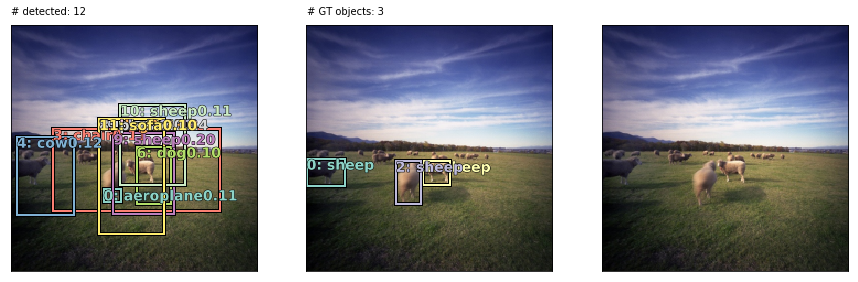

TP FP FN GTc   Category
0  1  0  0      aeroplane (cat0)
0  1  0  0      bird (cat2)
0  2  0  0      chair (cat8)
0  1  0  0      cow (cat9)
0  2  0  0      dog (cat11)
0  1  0  0      horse (cat12)
0  1  0  0      person (cat14)
0  2  3  3      sheep (cat16)
0  1  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.15


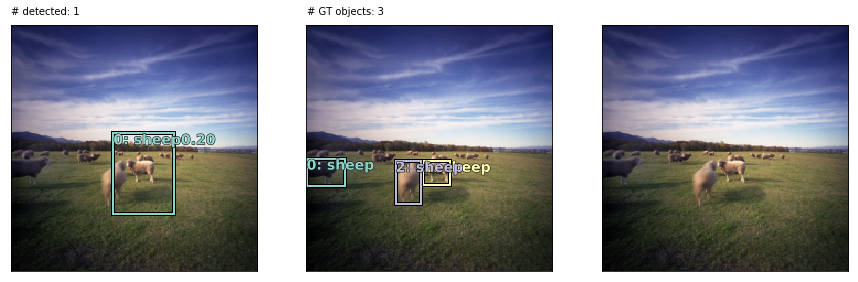

TP FP FN GTc   Category
0  1  3  3      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


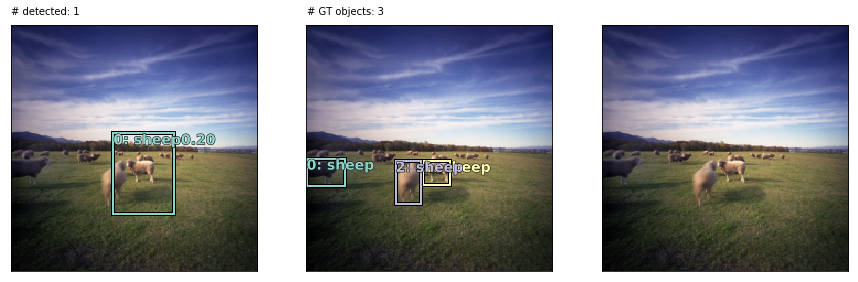

TP FP FN GTc   Category
0  1  3  3      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


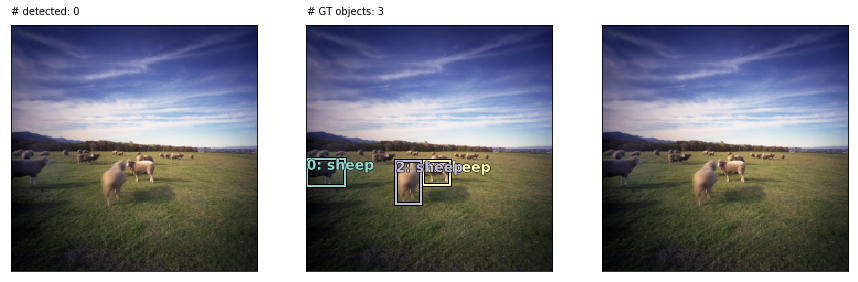

TP FP FN GTc   Category
0  0  3  3      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


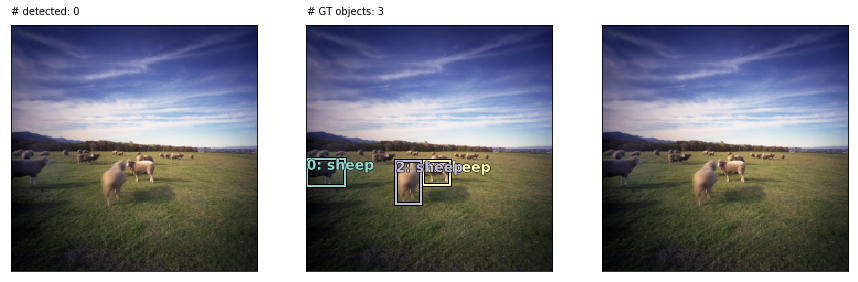

TP FP FN GTc   Category
0  0  3  3      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


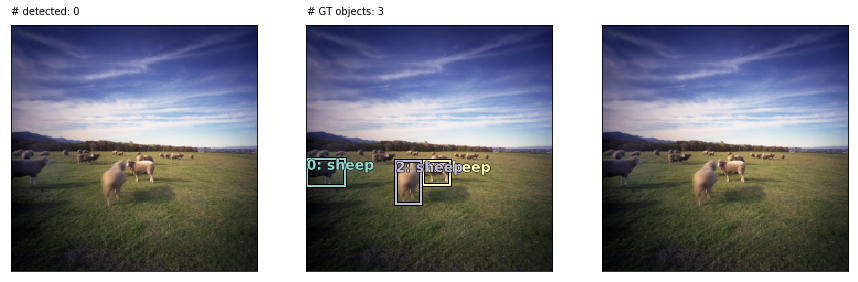

TP FP FN GTc   Category
0  0  3  3      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


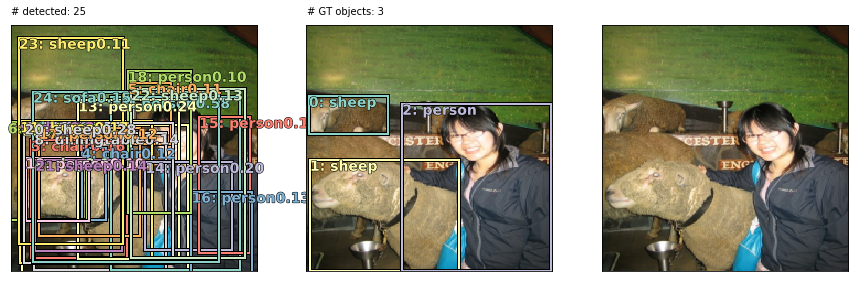

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
0  1  0  0      car (cat6)
0  1  0  0      cat (cat7)
0  4  0  0      chair (cat8)
0  1  0  0      cow (cat9)
0  1  0  0      diningtable (cat10)
0  2  0  0      dog (cat11)
0  1  0  0      horse (cat12)
1  7  0  1      person (cat14)
1  3  1  2      sheep (cat16)
0  1  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.15


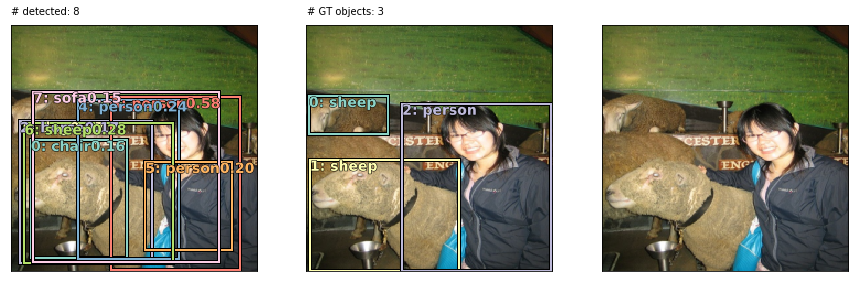

TP FP FN GTc   Category
0  1  0  0      chair (cat8)
0  1  0  0      dog (cat11)
0  1  0  0      horse (cat12)
1  2  0  1      person (cat14)
1  0  1  2      sheep (cat16)
0  1  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.20


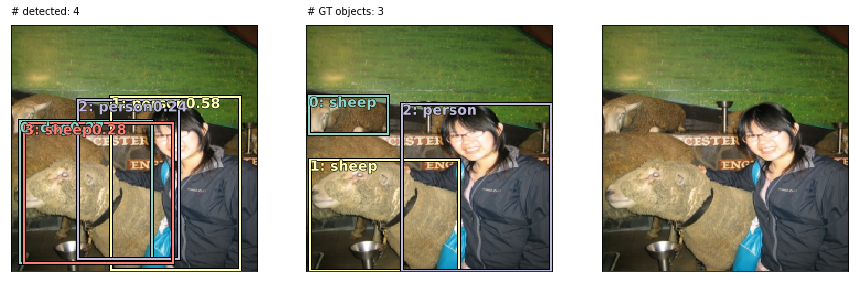

TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  1  0  1      person (cat14)
1  0  1  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


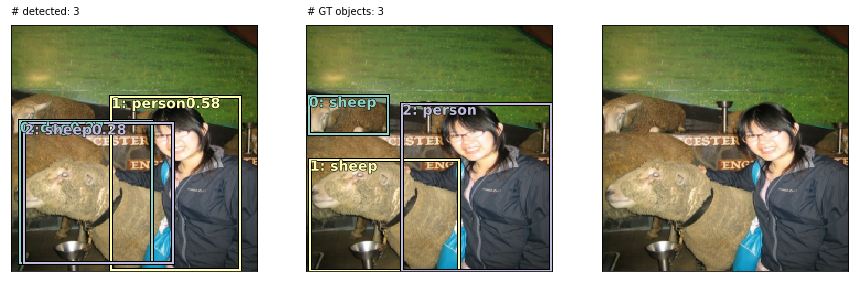

TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  0  0  1      person (cat14)
1  0  1  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


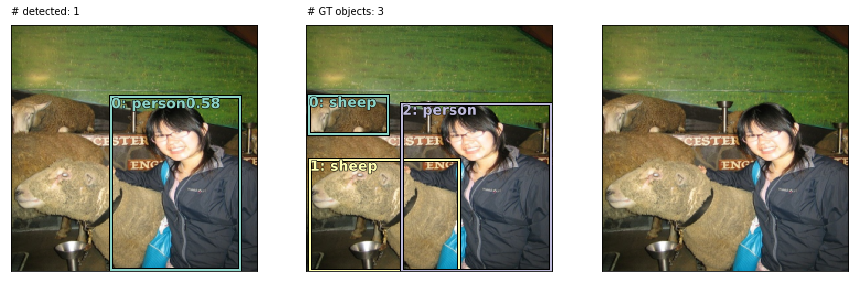

TP FP FN GTc   Category
1  0  0  1      person (cat14)
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


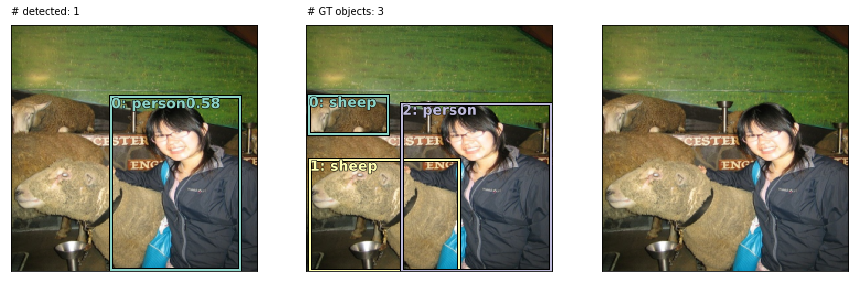

TP FP FN GTc   Category
1  0  0  1      person (cat14)
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


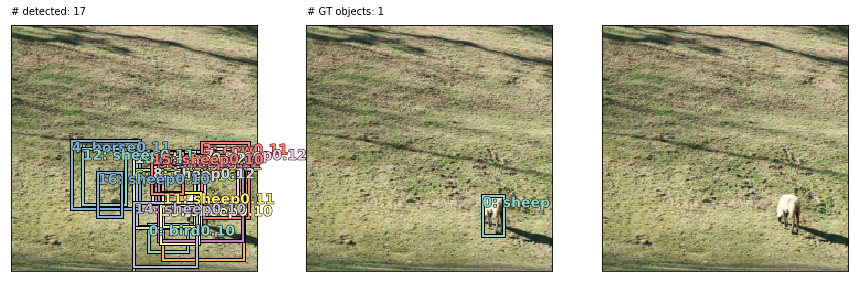

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
0  3  0  0      cow (cat9)
0  2  0  0      horse (cat12)
0  11  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.15


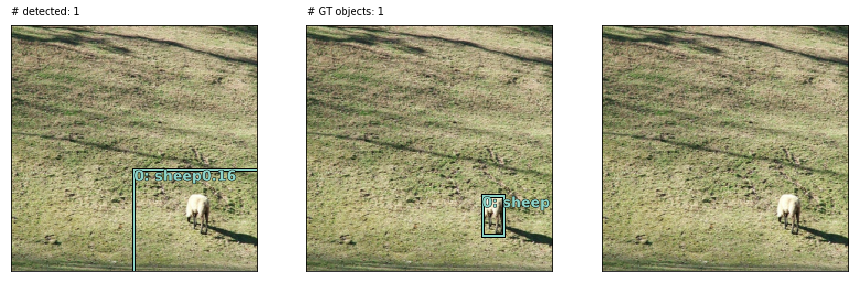

TP FP FN GTc   Category
0  1  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


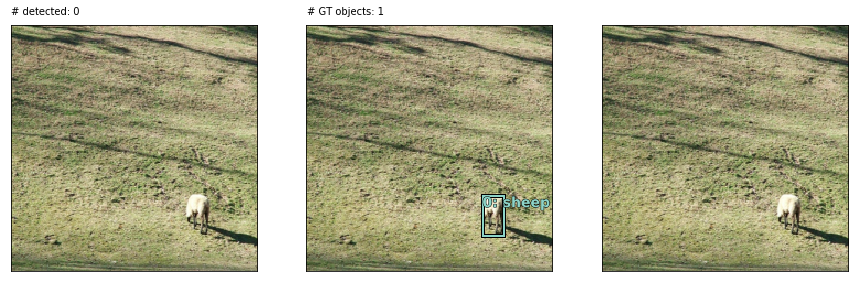

TP FP FN GTc   Category
0  0  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


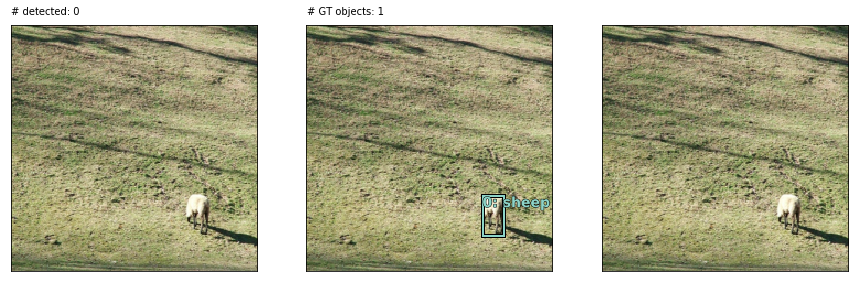

TP FP FN GTc   Category
0  0  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


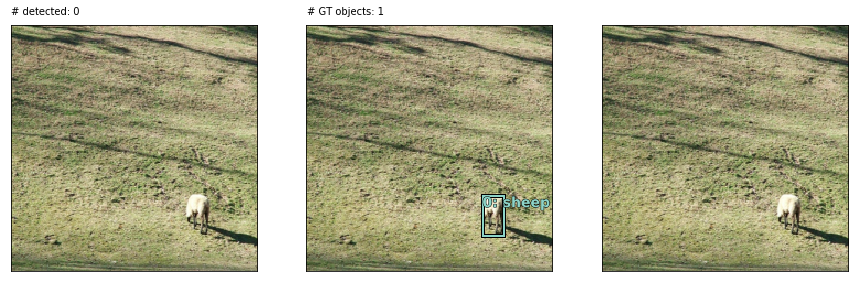

TP FP FN GTc   Category
0  0  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


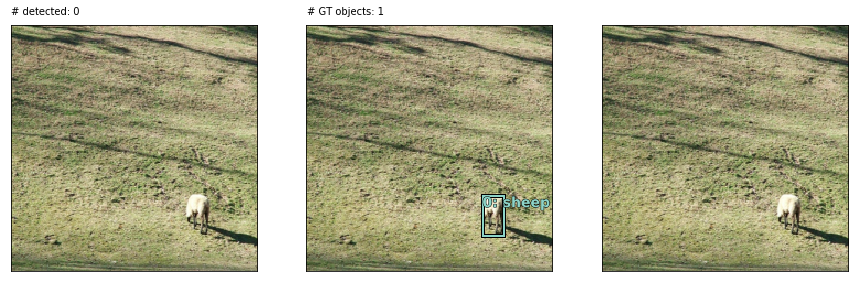

TP FP FN GTc   Category
0  0  1  1      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


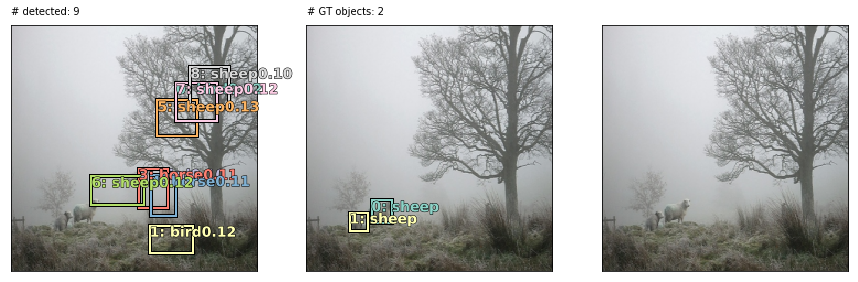

TP FP FN GTc   Category
0  3  0  0      bird (cat2)
0  2  0  0      horse (cat12)
0  4  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.15


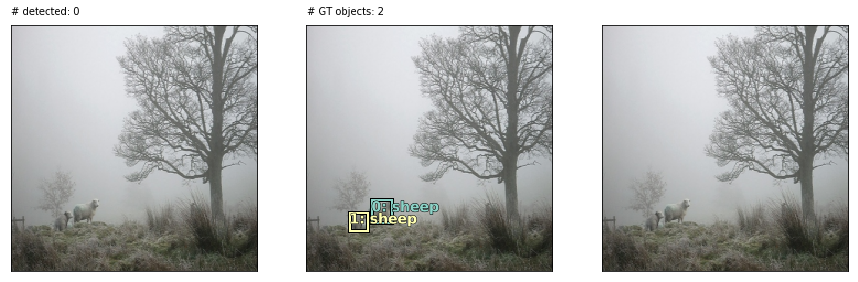

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


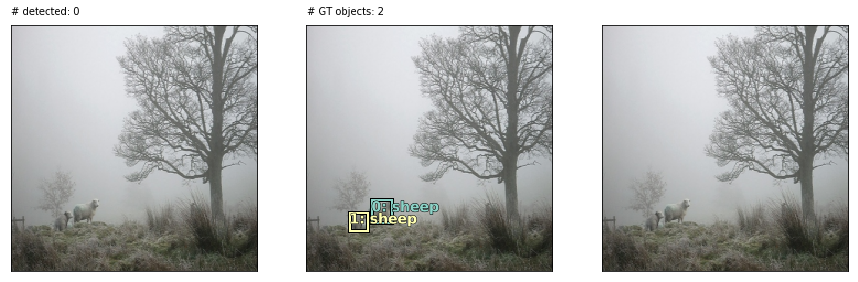

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


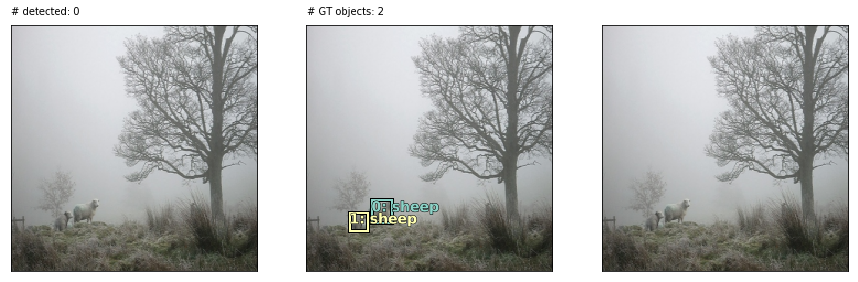

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


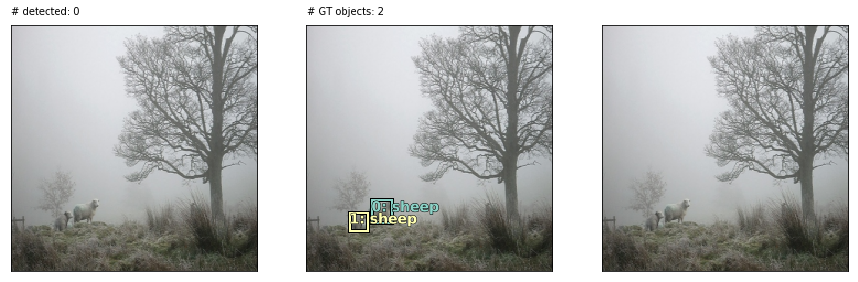

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


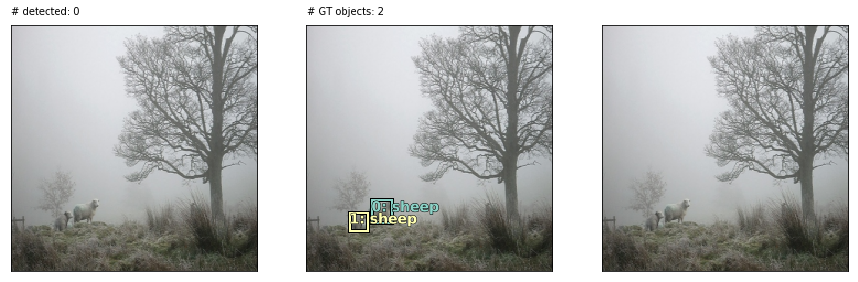

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


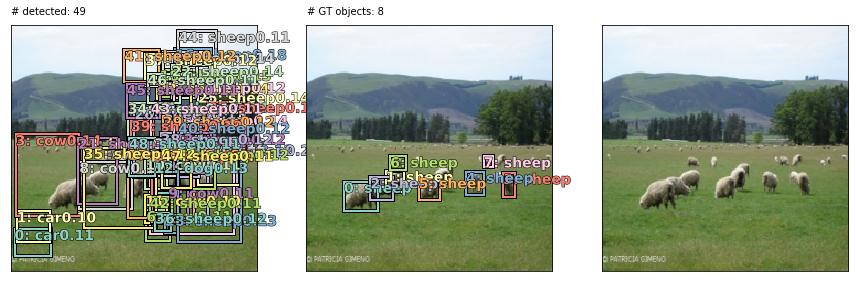

TP FP FN GTc   Category
0  2  0  0      car (cat6)
0  10  0  0      cow (cat9)
0  1  0  0      dog (cat11)
0  1  0  0      horse (cat12)
0  35  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.15


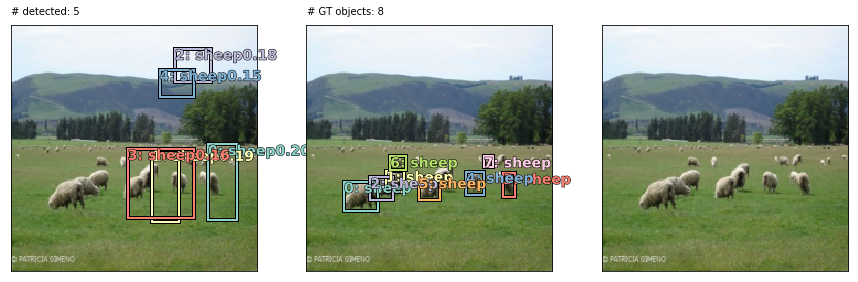

TP FP FN GTc   Category
0  5  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


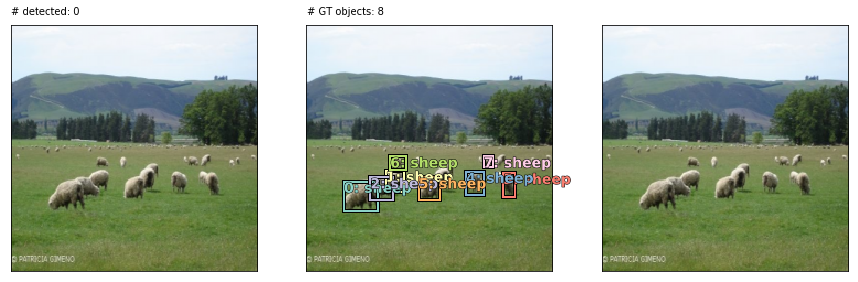

TP FP FN GTc   Category
0  0  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


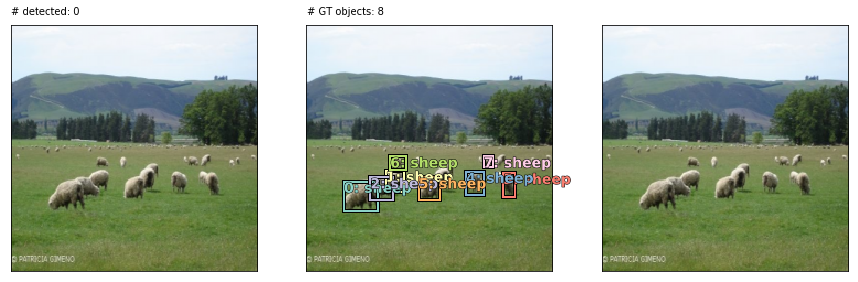

TP FP FN GTc   Category
0  0  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


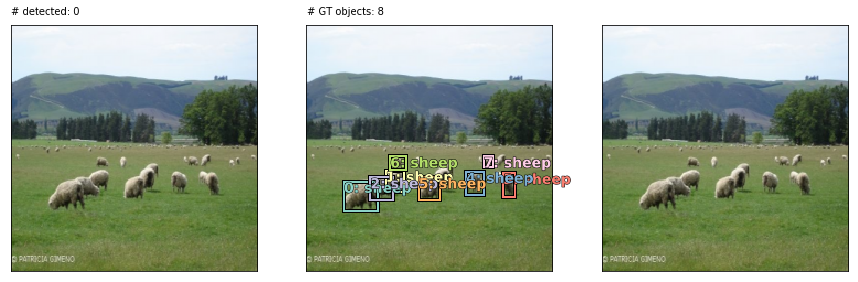

TP FP FN GTc   Category
0  0  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


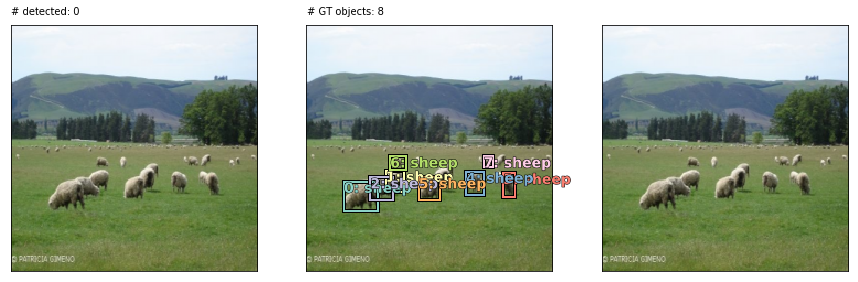

TP FP FN GTc   Category
0  0  8  8      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


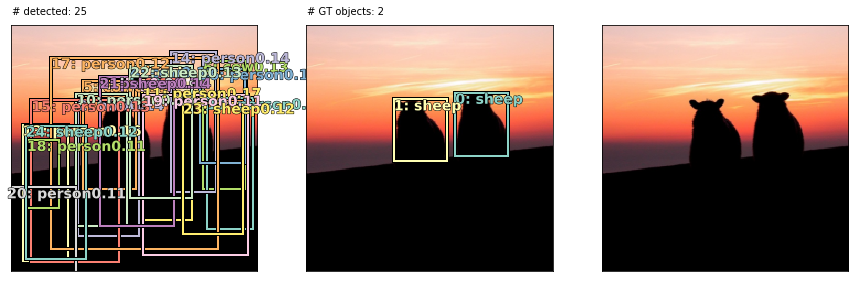

TP FP FN GTc   Category
0  3  0  0      bird (cat2)
0  1  0  0      cat (cat7)
0  3  0  0      cow (cat9)
0  1  0  0      dog (cat11)
0  1  0  0      horse (cat12)
0  12  0  0      person (cat14)
0  4  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.15


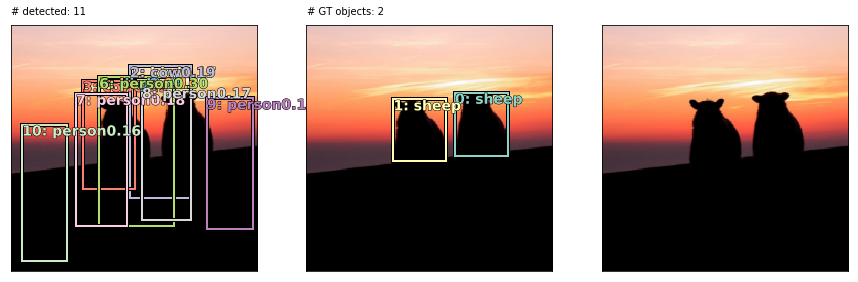

TP FP FN GTc   Category
0  2  0  0      bird (cat2)
0  2  0  0      cow (cat9)
0  1  0  0      dog (cat11)
0  1  0  0      horse (cat12)
0  5  0  0      person (cat14)
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


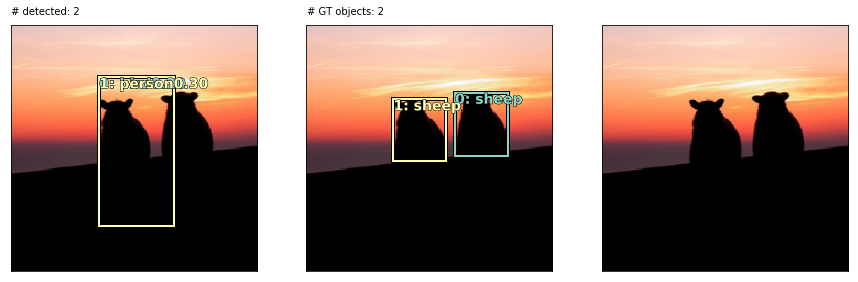

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
0  1  0  0      person (cat14)
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


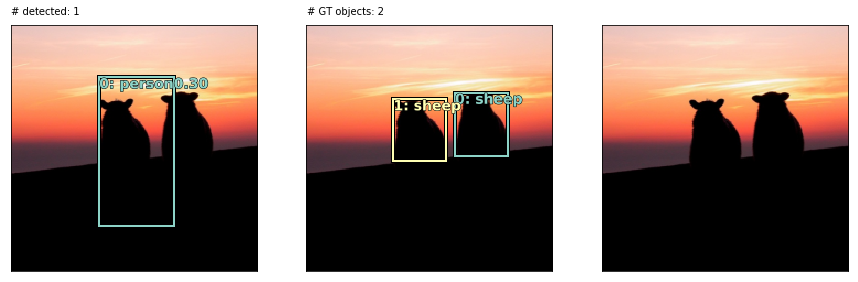

TP FP FN GTc   Category
0  1  0  0      person (cat14)
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


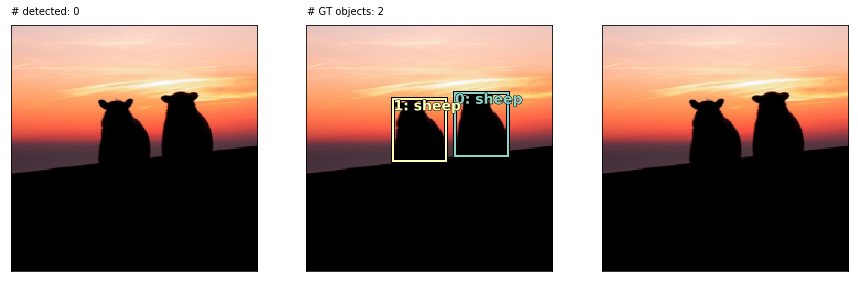

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


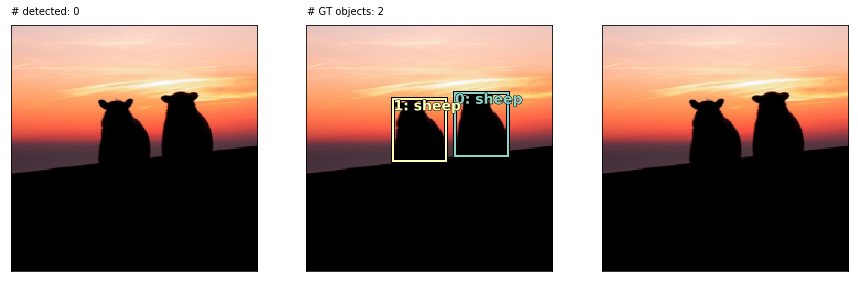

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.10


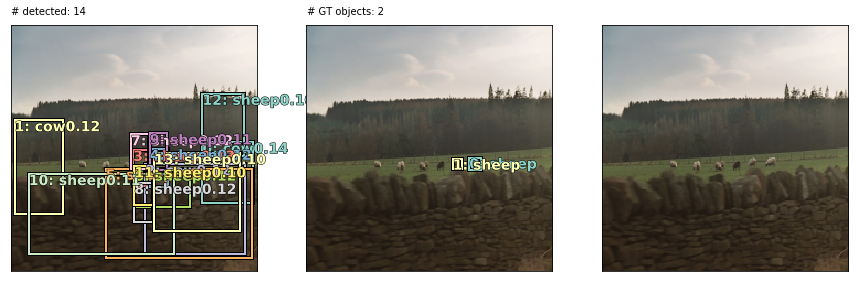

TP FP FN GTc   Category
0  3  0  0      cow (cat9)
0  11  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.15


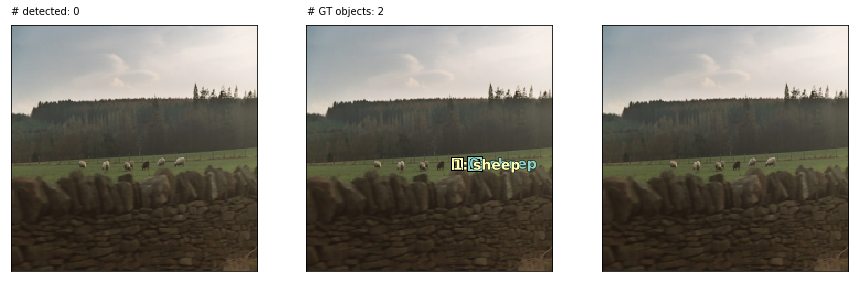

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.20


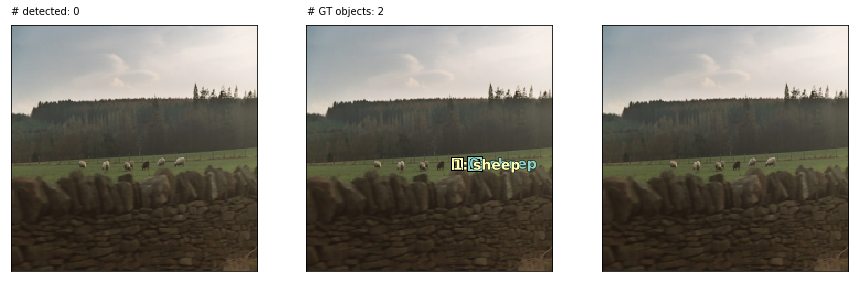

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.25


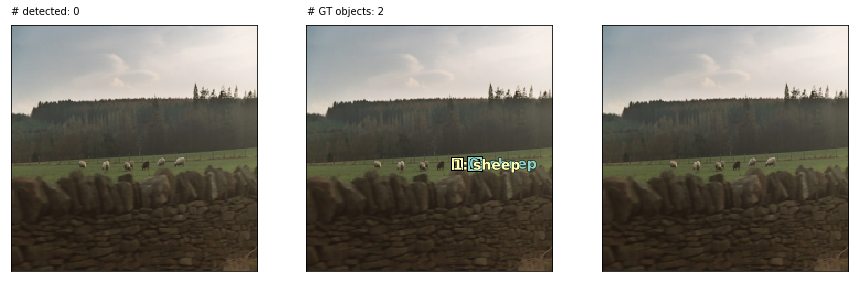

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.30


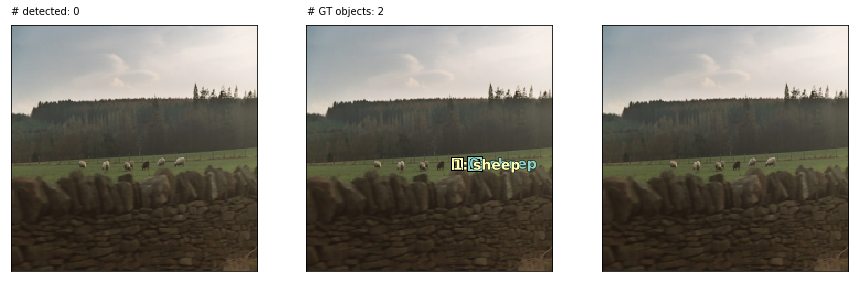

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)

NMS CONFIDENCE THRESHOLD: 0.35


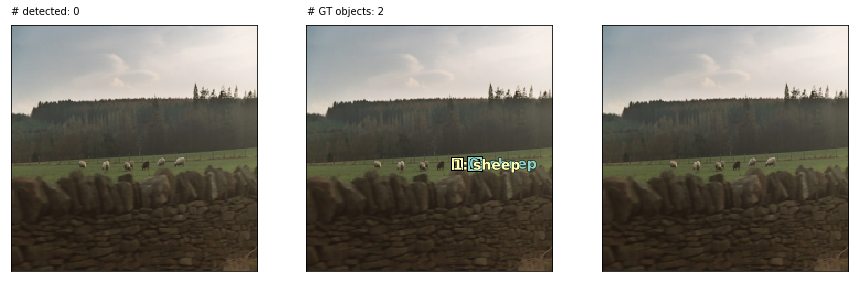

TP FP FN GTc   Category
0  0  2  2      sheep (cat16)


In [475]:
# look at sheep class cat16
search_cat = 16
found_objs = find_allgt_cat(search_cat)

threshrange = np.linspace(.1, 0.35, 6, endpoint=True)

for i in range(len(found_objs)):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)


NMS CONFIDENCE THRESHOLD: 0.10


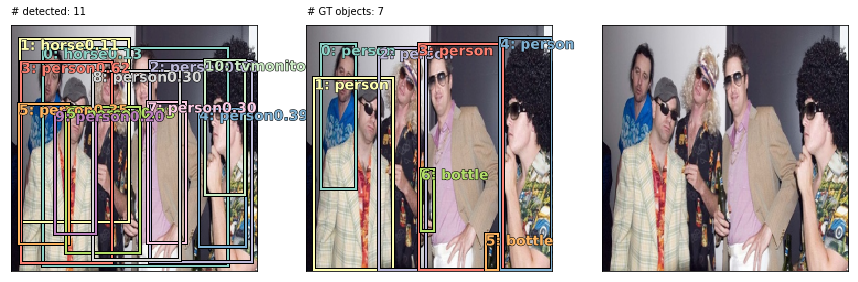

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
0  2  0  0      horse (cat12)
1  7  4  5      person (cat14)
0  1  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.15


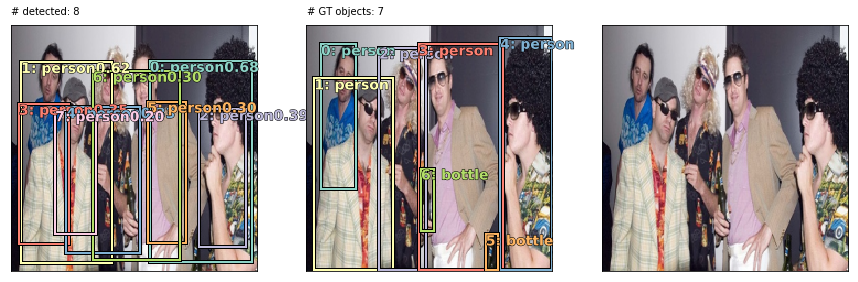

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  7  4  5      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


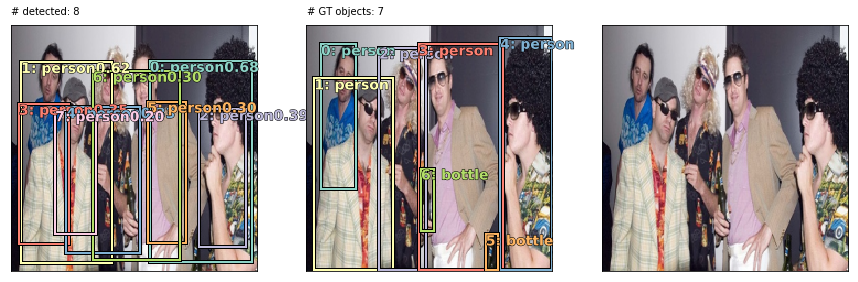

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  7  4  5      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


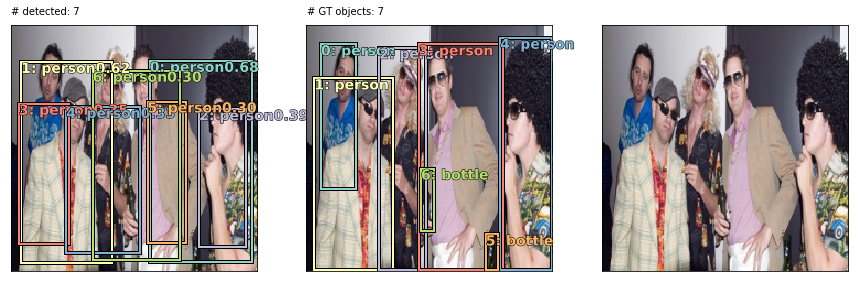

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  6  4  5      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


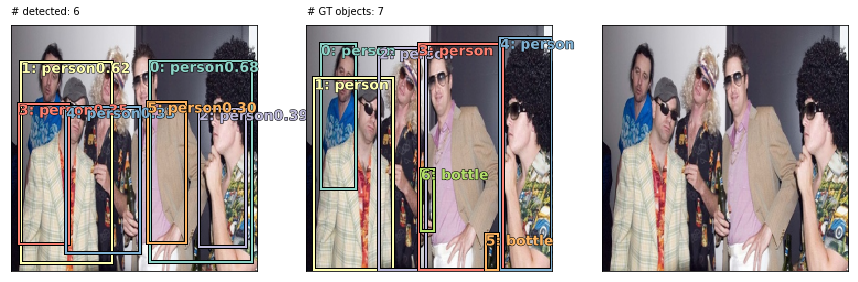

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  5  4  5      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


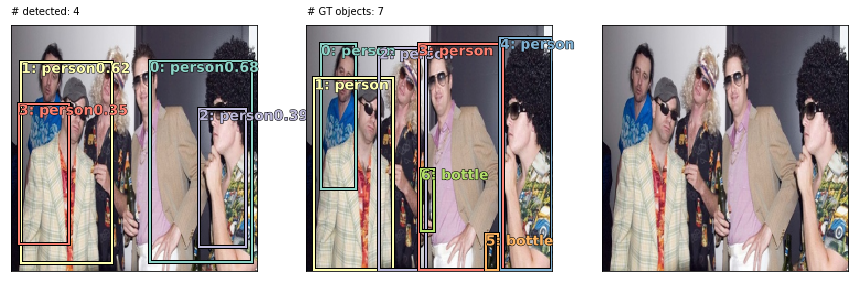

TP FP FN GTc   Category
0  0  2  2      bottle (cat4)
1  3  4  5      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.10


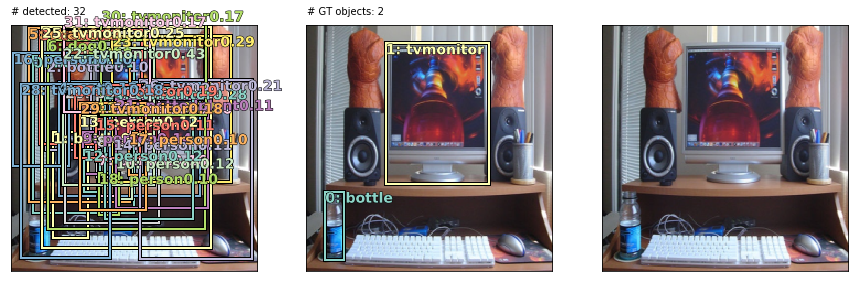

TP FP FN GTc   Category
0  3  1  1      bottle (cat4)
0  2  0  0      cat (cat7)
0  1  0  0      chair (cat8)
0  1  0  0      dog (cat11)
0  13  0  0      person (cat14)
0  2  0  0      pottedplant (cat15)
1  9  0  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.15


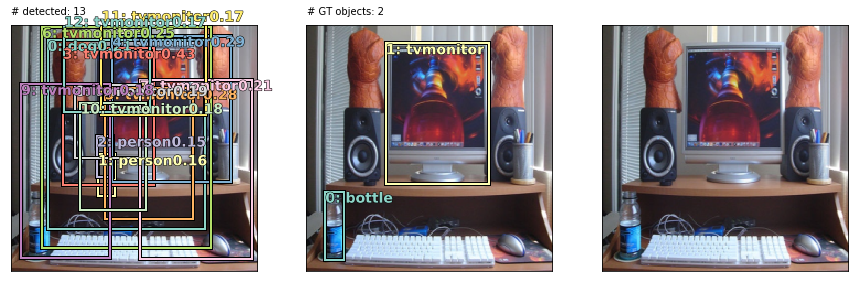

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
0  1  0  0      dog (cat11)
0  2  0  0      person (cat14)
1  9  0  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.20


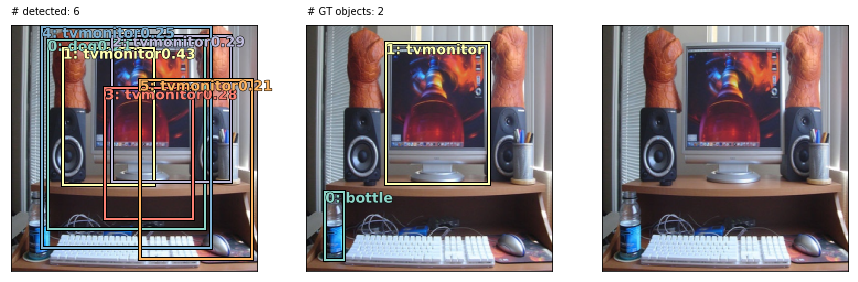

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
0  1  0  0      dog (cat11)
1  4  0  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.25


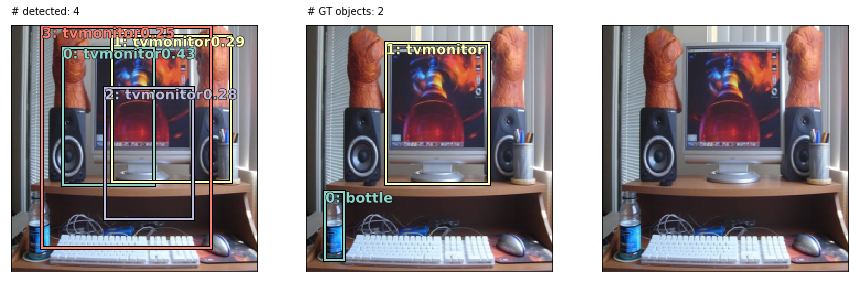

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
1  3  0  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.30


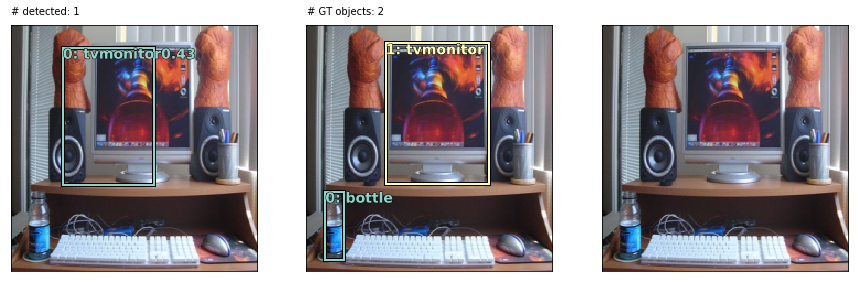

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
0  1  1  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.35


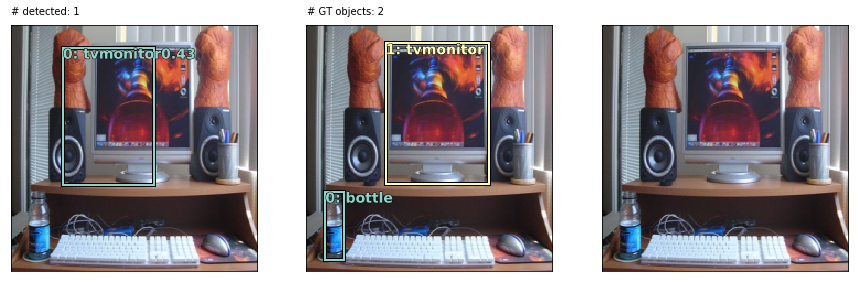

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
0  1  1  1      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.10


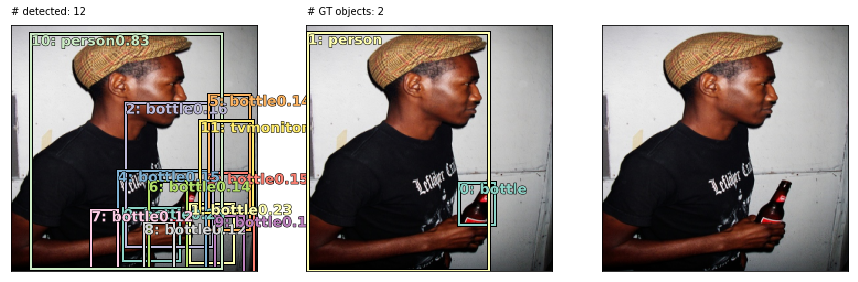

TP FP FN GTc   Category
0  10  1  1      bottle (cat4)
1  0  0  1      person (cat14)
0  1  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.15


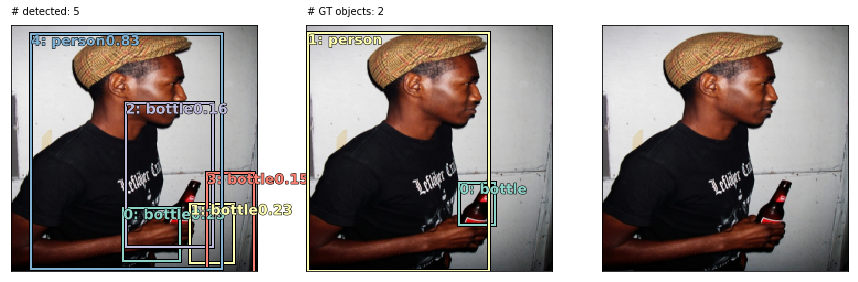

TP FP FN GTc   Category
0  4  1  1      bottle (cat4)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


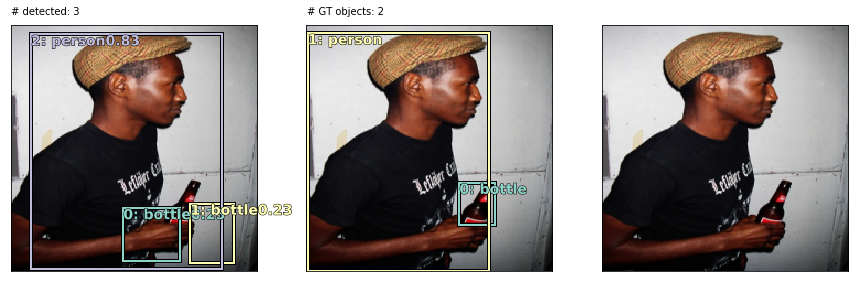

TP FP FN GTc   Category
0  2  1  1      bottle (cat4)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


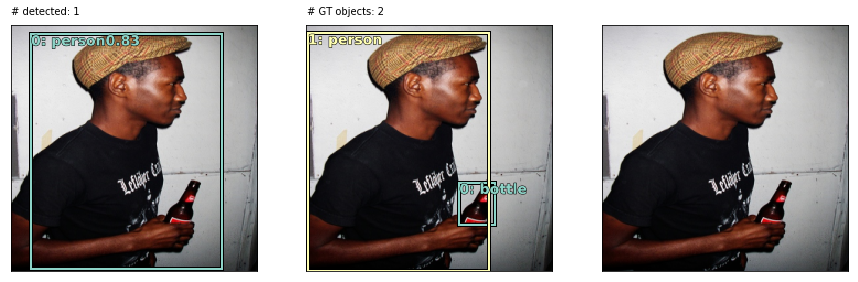

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


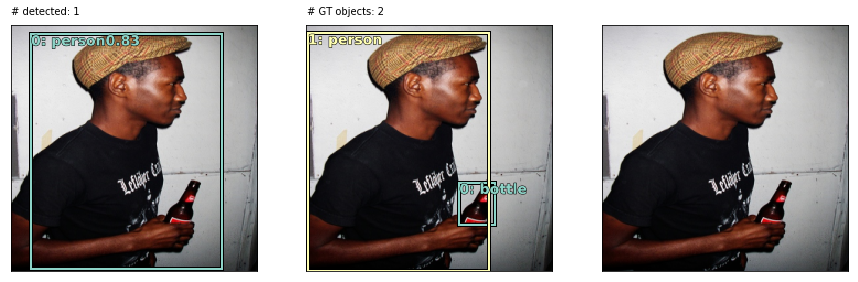

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


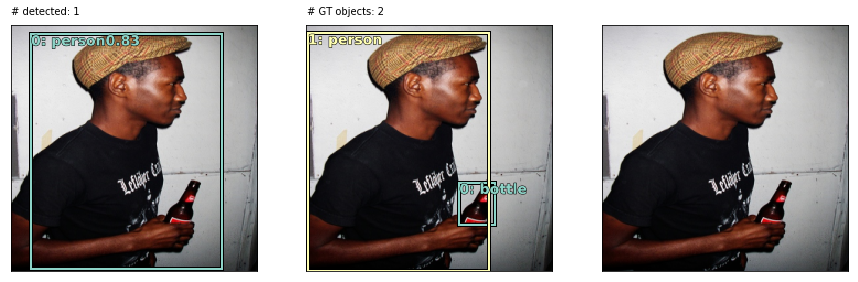

TP FP FN GTc   Category
0  0  1  1      bottle (cat4)
1  0  0  1      person (cat14)


In [476]:
search_cat=4
found_objs = find_allgt_cat(search_cat)
#found_objs[:5]

for i in range(3):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)


NMS CONFIDENCE THRESHOLD: 0.10


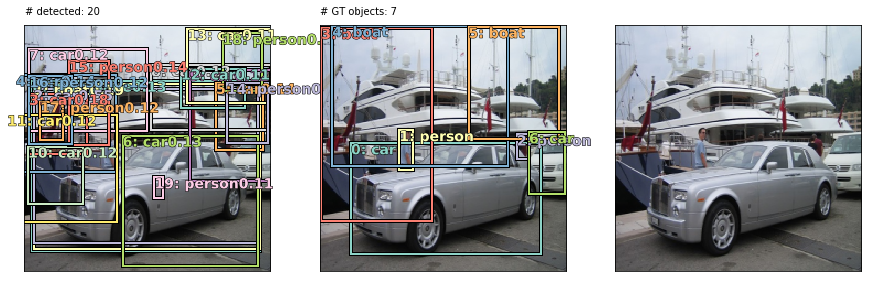

TP FP FN GTc   Category
0  1  0  0      aeroplane (cat0)
0  1  3  3      boat (cat3)
1  11  1  2      car (cat6)
0  6  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


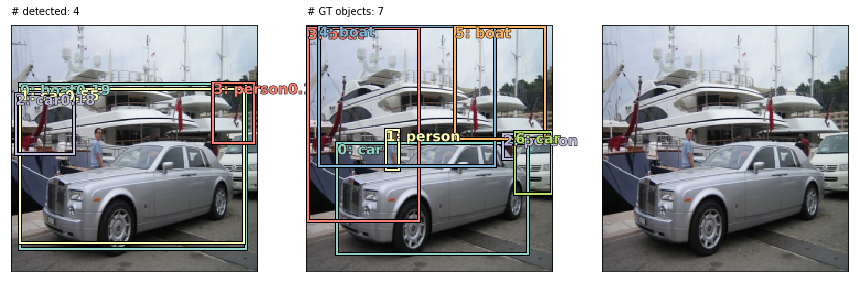

TP FP FN GTc   Category
0  1  3  3      boat (cat3)
1  1  1  2      car (cat6)
0  1  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


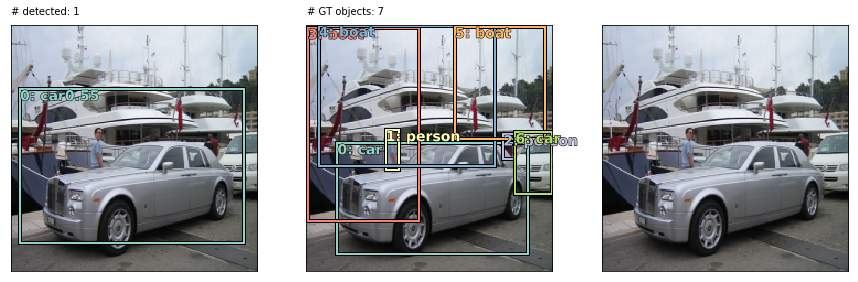

TP FP FN GTc   Category
0  0  3  3      boat (cat3)
1  0  1  2      car (cat6)
0  0  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


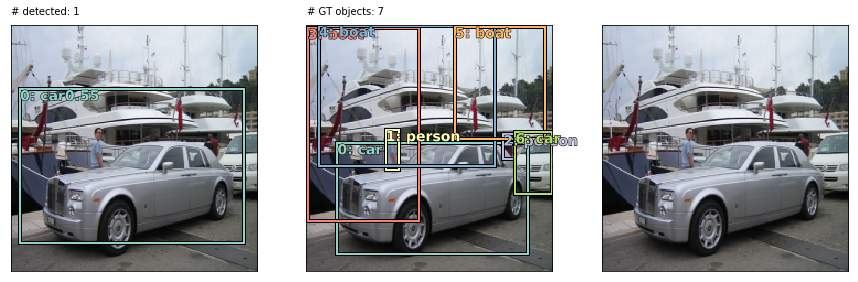

TP FP FN GTc   Category
0  0  3  3      boat (cat3)
1  0  1  2      car (cat6)
0  0  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


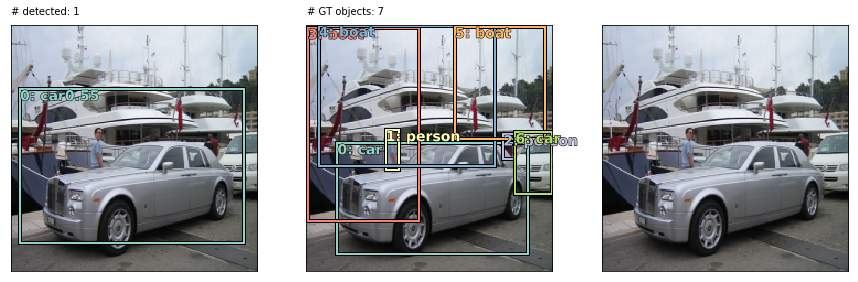

TP FP FN GTc   Category
0  0  3  3      boat (cat3)
1  0  1  2      car (cat6)
0  0  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


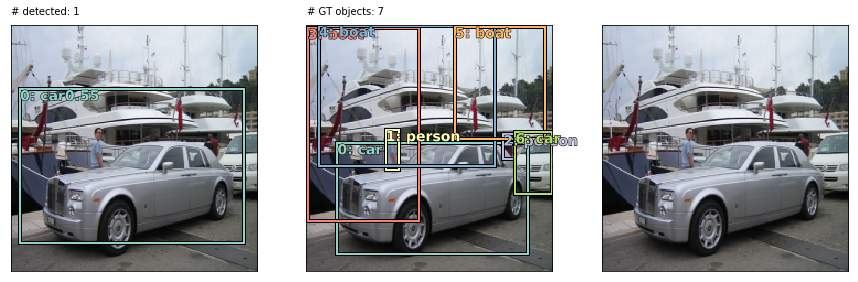

TP FP FN GTc   Category
0  0  3  3      boat (cat3)
1  0  1  2      car (cat6)
0  0  2  2      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.10


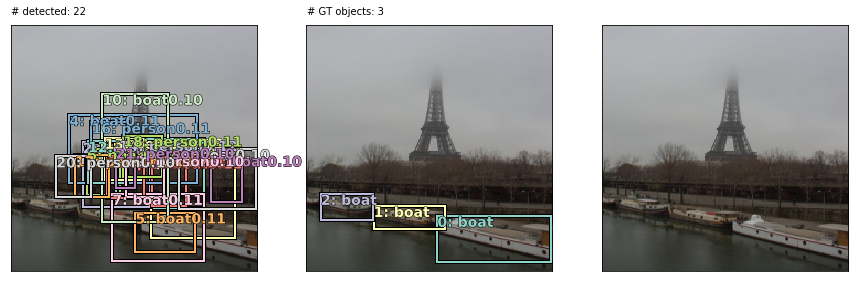

TP FP FN GTc   Category
0  11  3  3      boat (cat3)
0  1  0  0      car (cat6)
0  10  0  0      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


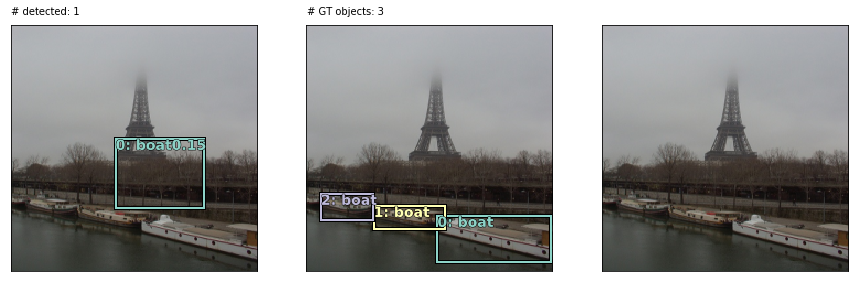

TP FP FN GTc   Category
0  1  3  3      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.20


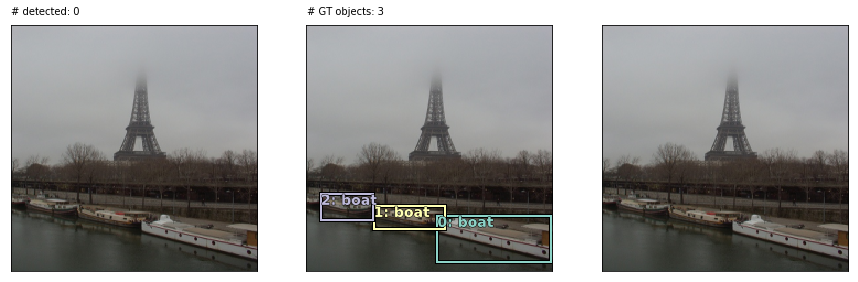

TP FP FN GTc   Category
0  0  3  3      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.25


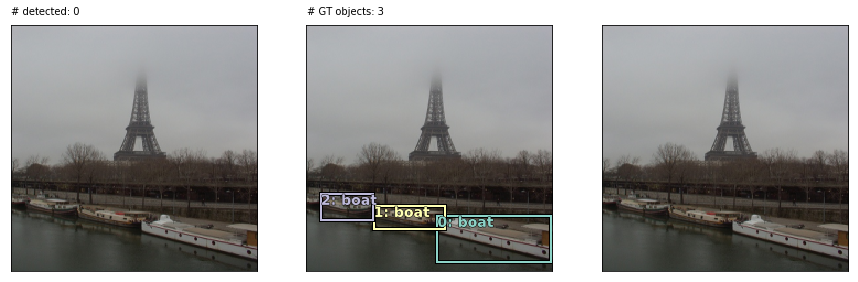

TP FP FN GTc   Category
0  0  3  3      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.30


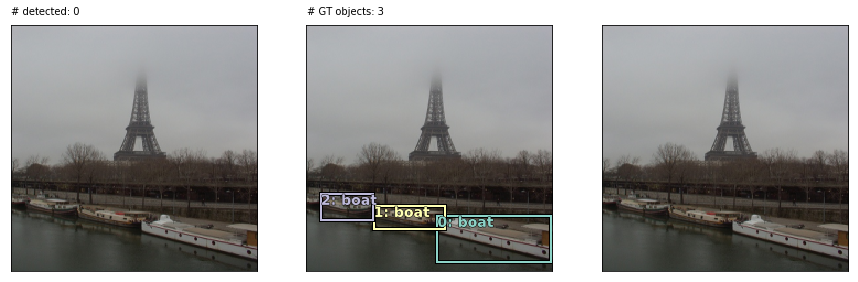

TP FP FN GTc   Category
0  0  3  3      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.35


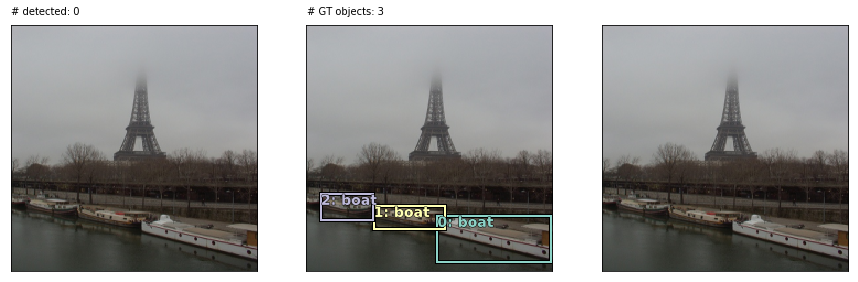

TP FP FN GTc   Category
0  0  3  3      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.10


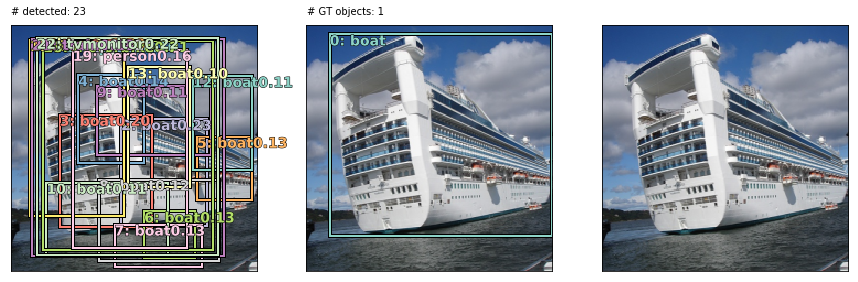

TP FP FN GTc   Category
0  1  0  0      aeroplane (cat0)
1  12  0  1      boat (cat3)
0  1  0  0      bottle (cat4)
0  1  0  0      bus (cat5)
0  1  0  0      car (cat6)
0  1  0  0      horse (cat12)
0  1  0  0      motorbike (cat13)
0  1  0  0      person (cat14)
0  1  0  0      sheep (cat16)
0  1  0  0      train (cat18)
0  1  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.15


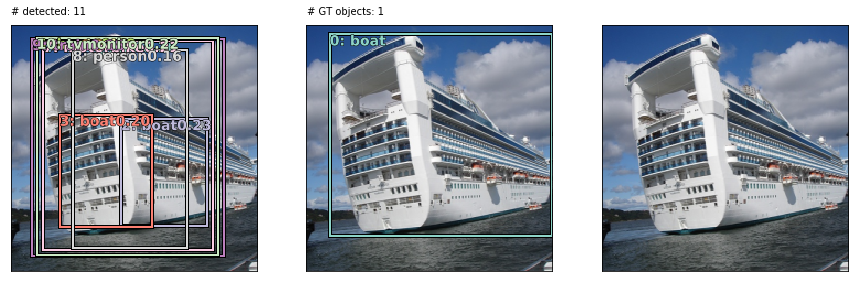

TP FP FN GTc   Category
0  1  0  0      aeroplane (cat0)
1  2  0  1      boat (cat3)
0  1  0  0      bottle (cat4)
0  1  0  0      bus (cat5)
0  1  0  0      horse (cat12)
0  1  0  0      motorbike (cat13)
0  1  0  0      person (cat14)
0  1  0  0      train (cat18)
0  1  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.20


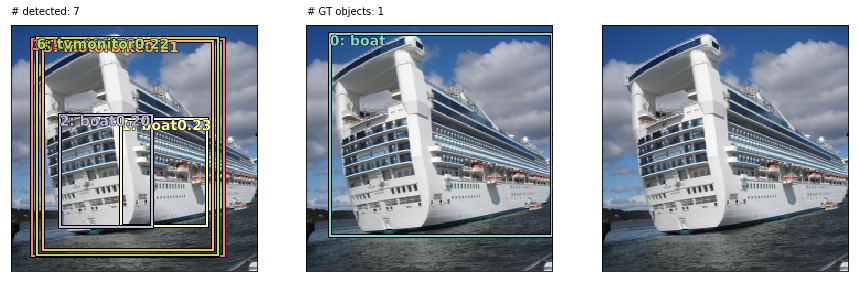

TP FP FN GTc   Category
1  2  0  1      boat (cat3)
0  1  0  0      bus (cat5)
0  1  0  0      horse (cat12)
0  1  0  0      motorbike (cat13)
0  1  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.25


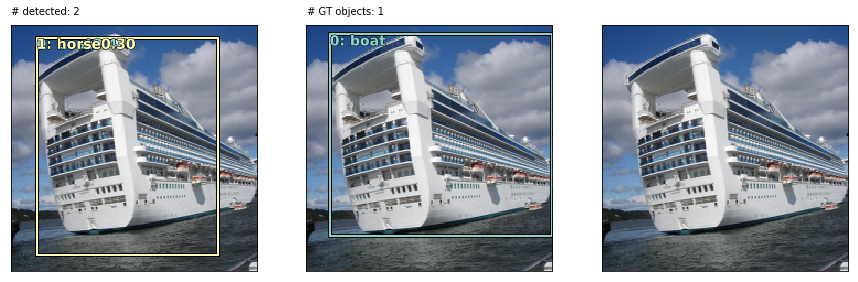

TP FP FN GTc   Category
1  0  0  1      boat (cat3)
0  1  0  0      horse (cat12)

NMS CONFIDENCE THRESHOLD: 0.30


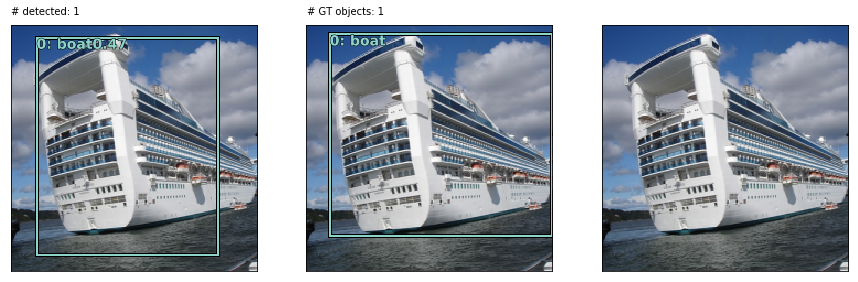

TP FP FN GTc   Category
1  0  0  1      boat (cat3)

NMS CONFIDENCE THRESHOLD: 0.35


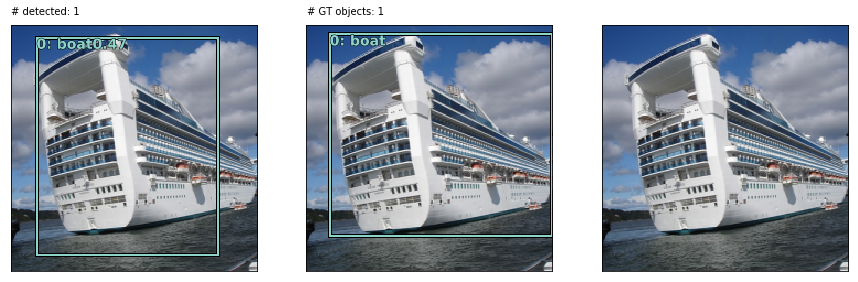

TP FP FN GTc   Category
1  0  0  1      boat (cat3)


In [477]:
search_cat=3
found_objs = find_allgt_cat(search_cat)
#found_objs[:5]

for i in range(3):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)


NMS CONFIDENCE THRESHOLD: 0.10


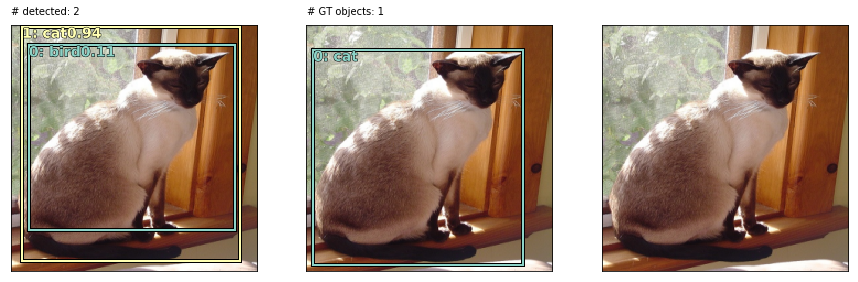

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.15


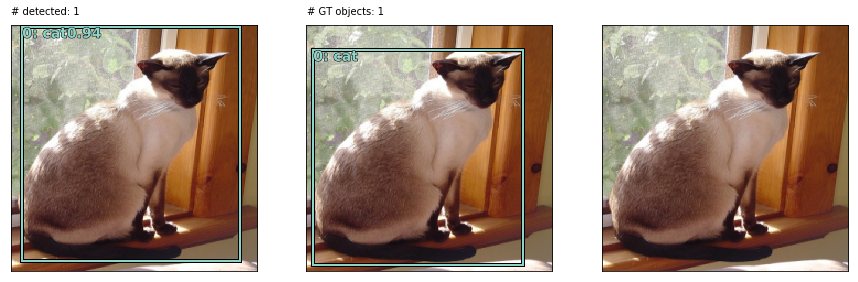

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.20


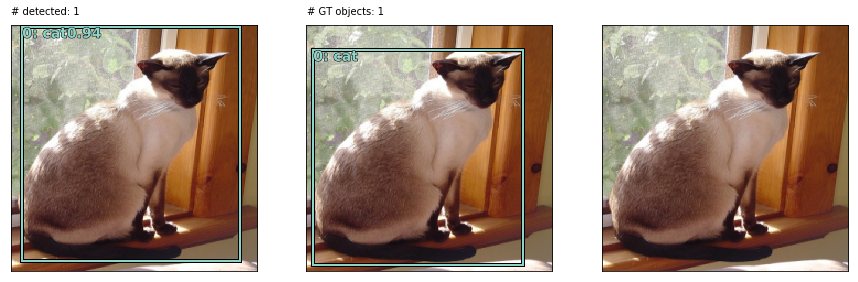

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.25


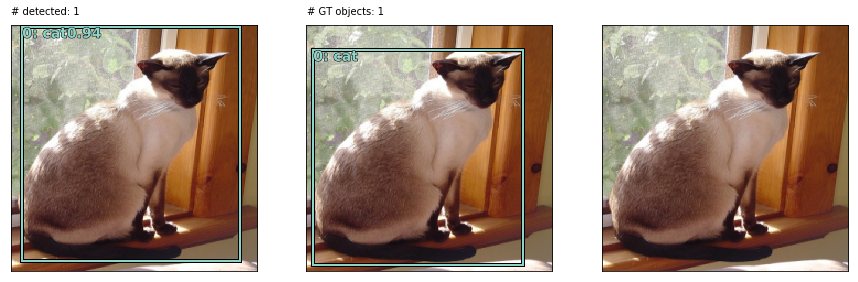

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.30


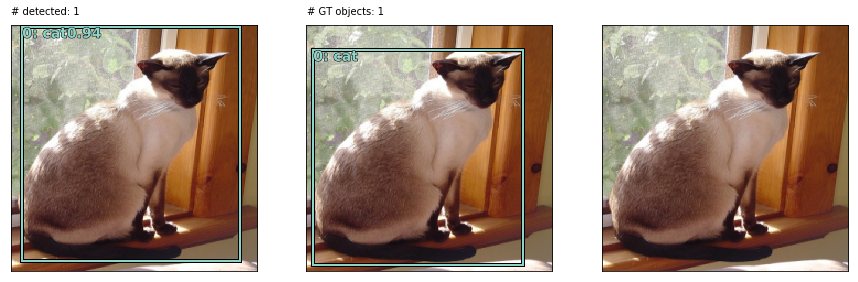

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.35


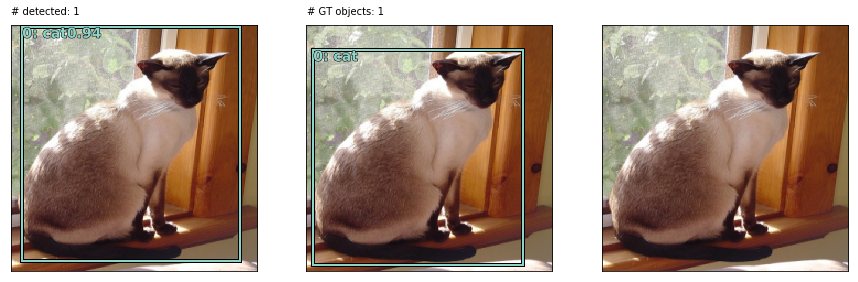

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.10


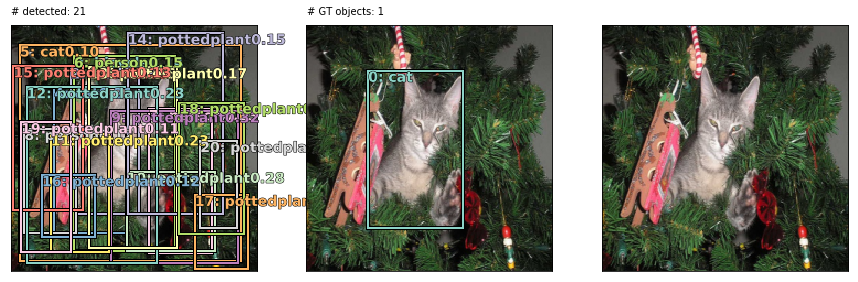

TP FP FN GTc   Category
0  1  0  0      bicycle (cat1)
0  2  0  0      bird (cat2)
1  2  0  1      cat (cat7)
0  3  0  0      person (cat14)
0  12  0  0      pottedplant (cat15)

NMS CONFIDENCE THRESHOLD: 0.15


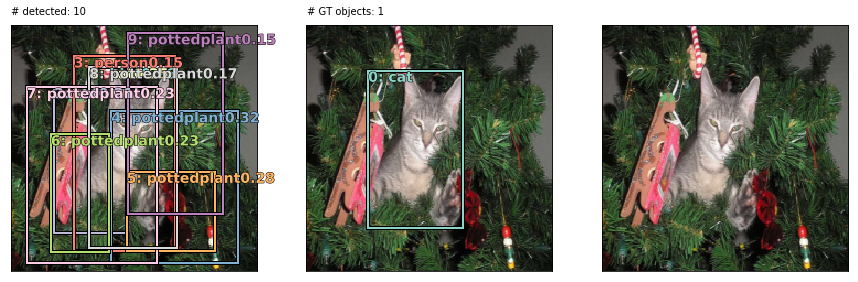

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
1  1  0  1      cat (cat7)
0  1  0  0      person (cat14)
0  6  0  0      pottedplant (cat15)

NMS CONFIDENCE THRESHOLD: 0.20


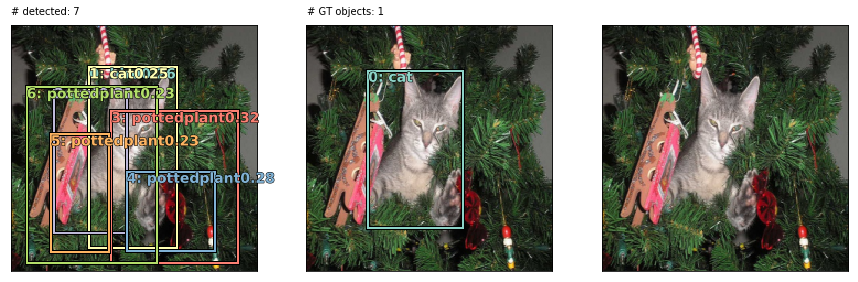

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
1  1  0  1      cat (cat7)
0  4  0  0      pottedplant (cat15)

NMS CONFIDENCE THRESHOLD: 0.25


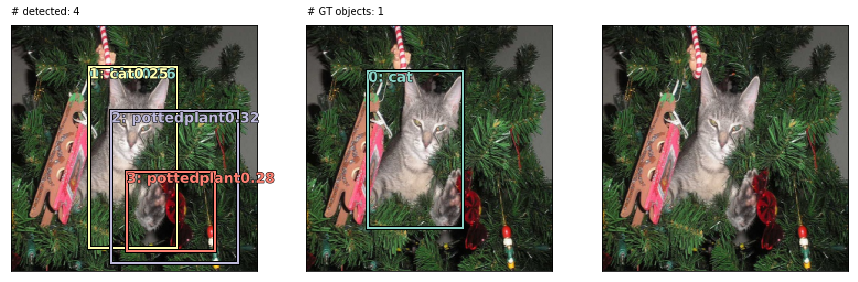

TP FP FN GTc   Category
0  1  0  0      bird (cat2)
1  0  0  1      cat (cat7)
0  2  0  0      pottedplant (cat15)

NMS CONFIDENCE THRESHOLD: 0.30


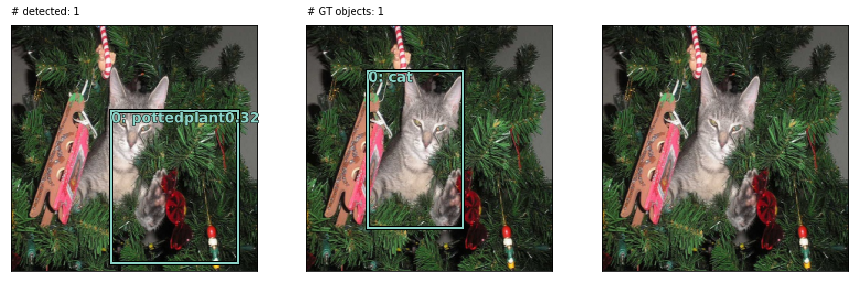

TP FP FN GTc   Category
0  0  1  1      cat (cat7)
0  1  0  0      pottedplant (cat15)

NMS CONFIDENCE THRESHOLD: 0.35


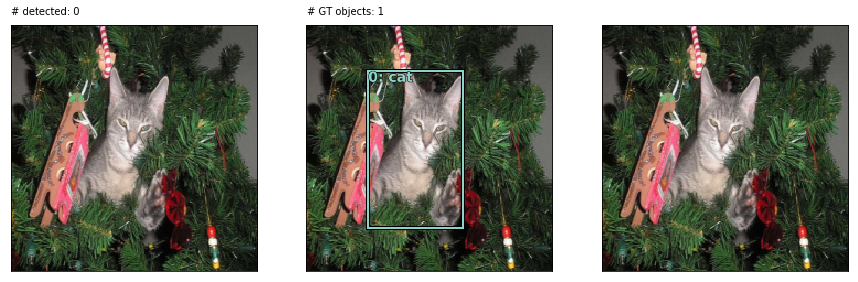

TP FP FN GTc   Category
0  0  1  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.10


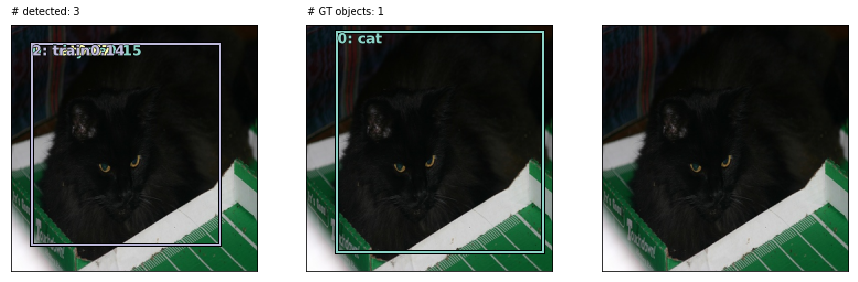

TP FP FN GTc   Category
0  1  0  0      bicycle (cat1)
1  0  0  1      cat (cat7)
0  1  0  0      train (cat18)

NMS CONFIDENCE THRESHOLD: 0.15


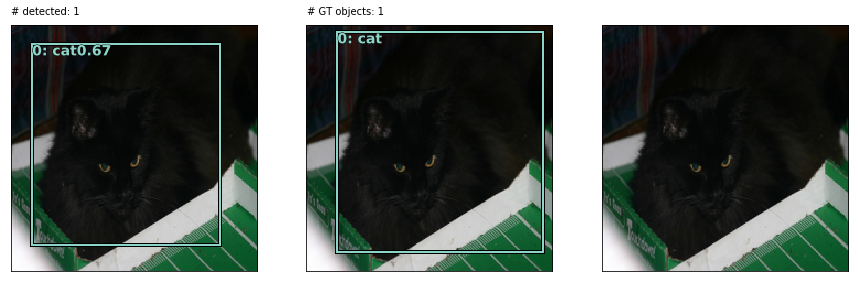

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.20


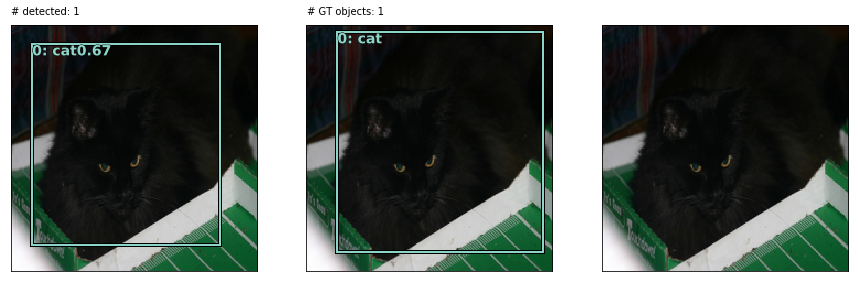

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.25


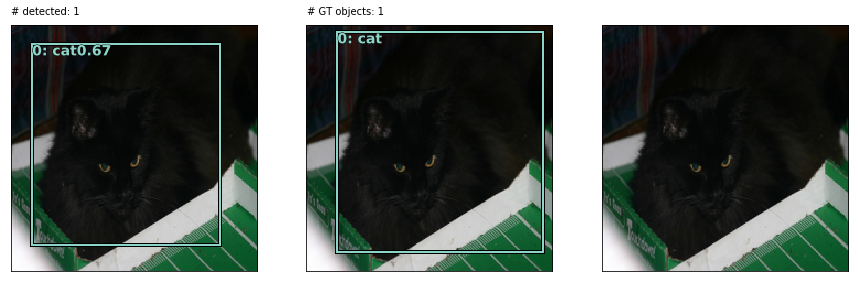

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.30


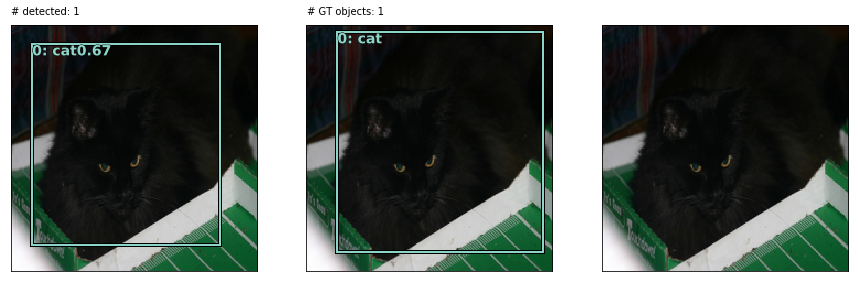

TP FP FN GTc   Category
1  0  0  1      cat (cat7)

NMS CONFIDENCE THRESHOLD: 0.35


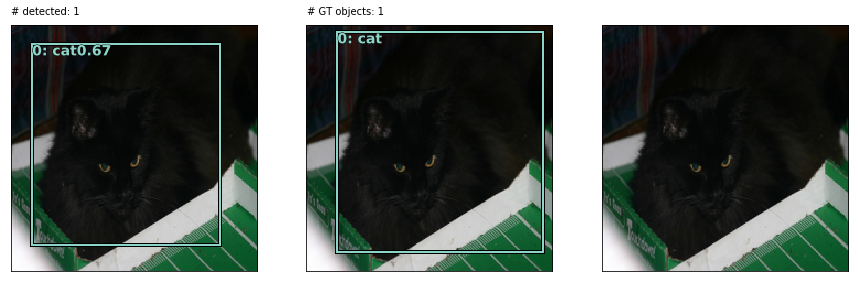

TP FP FN GTc   Category
1  0  0  1      cat (cat7)


In [478]:
search_cat=7
found_objs = find_allgt_cat(search_cat)
found_objs[:5]

for i in range(3):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



NMS CONFIDENCE THRESHOLD: 0.10


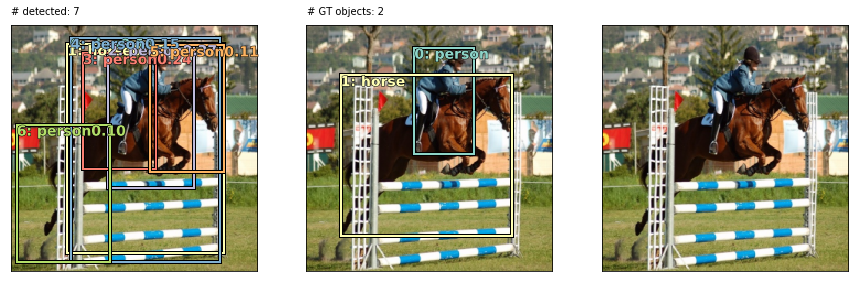

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  0  0  1      horse (cat12)
1  4  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


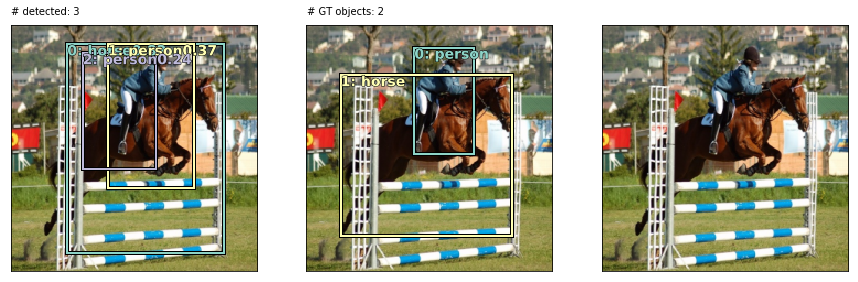

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  1  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


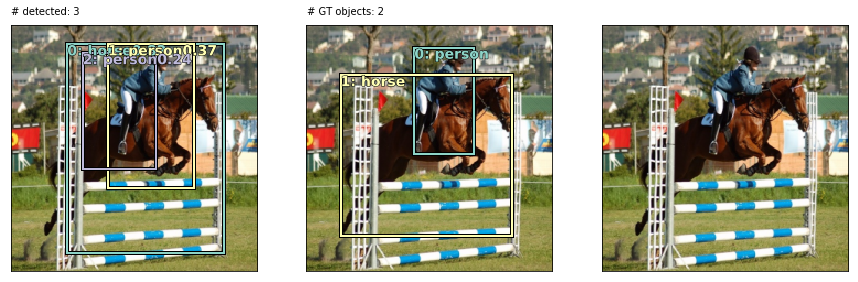

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  1  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


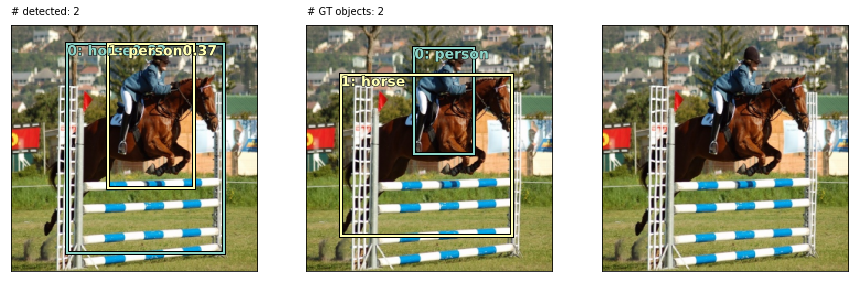

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


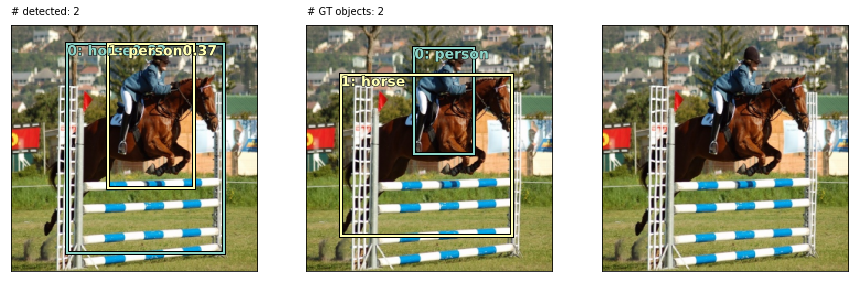

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


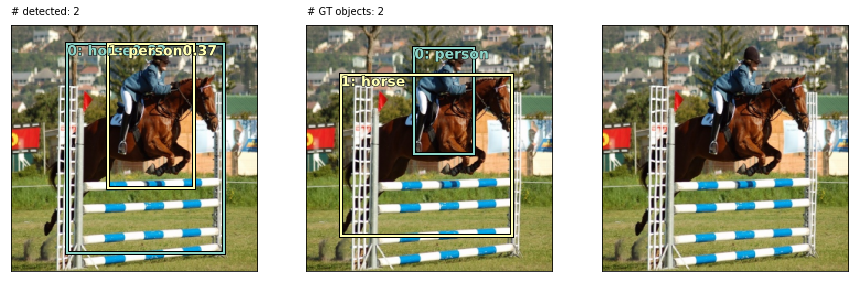

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.10


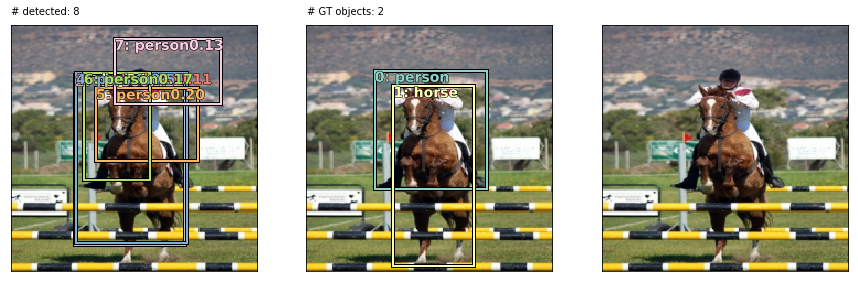

TP FP FN GTc   Category
0  1  0  0      chair (cat8)
0  1  0  0      dog (cat11)
1  0  0  1      horse (cat12)
0  1  0  0      motorbike (cat13)
1  3  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


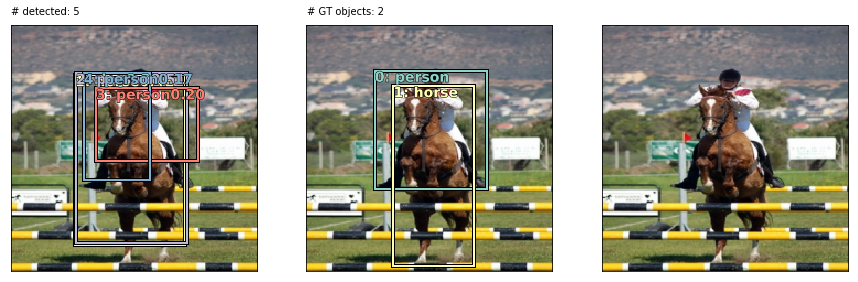

TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  0  0  1      horse (cat12)
1  2  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


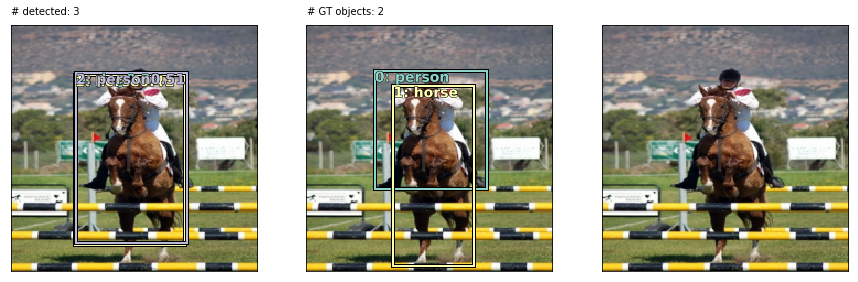

TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


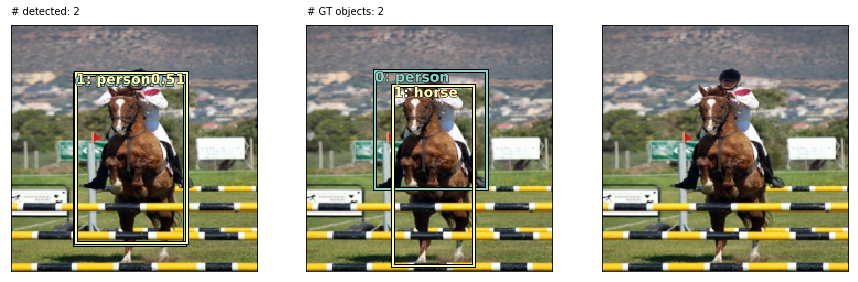

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


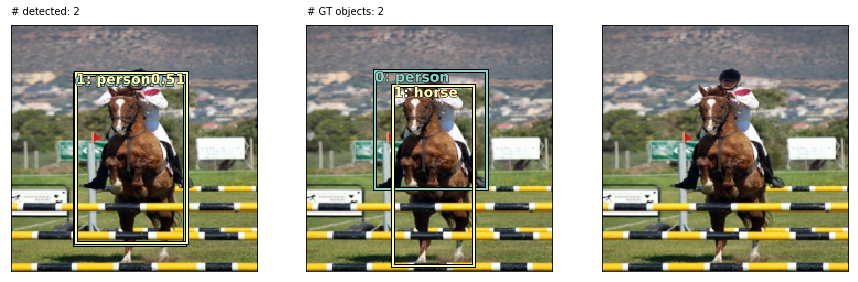

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


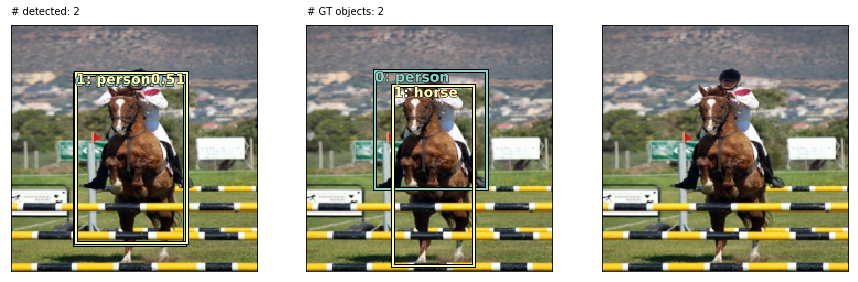

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
1  0  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.10


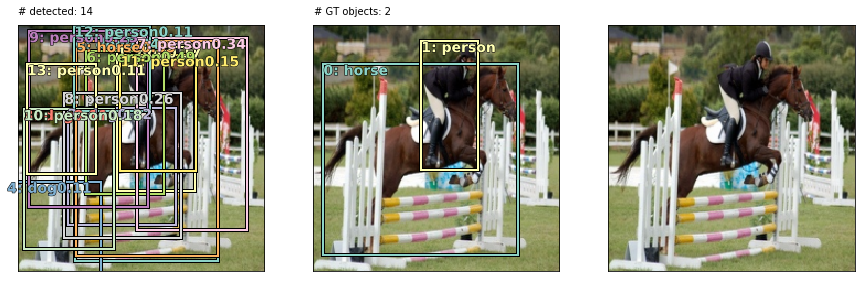

TP FP FN GTc   Category
0  5  0  0      dog (cat11)
1  0  0  1      horse (cat12)
1  7  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


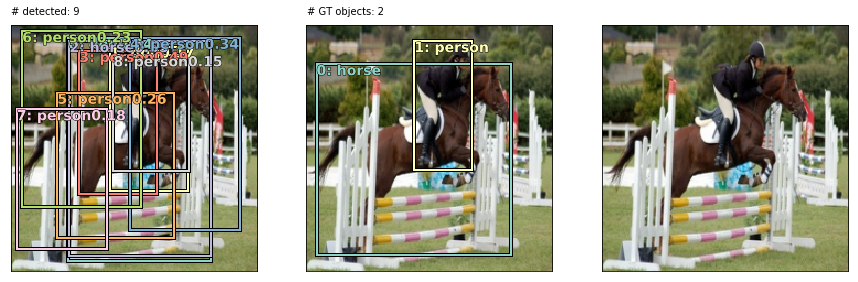

TP FP FN GTc   Category
0  2  0  0      dog (cat11)
1  0  0  1      horse (cat12)
1  5  0  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


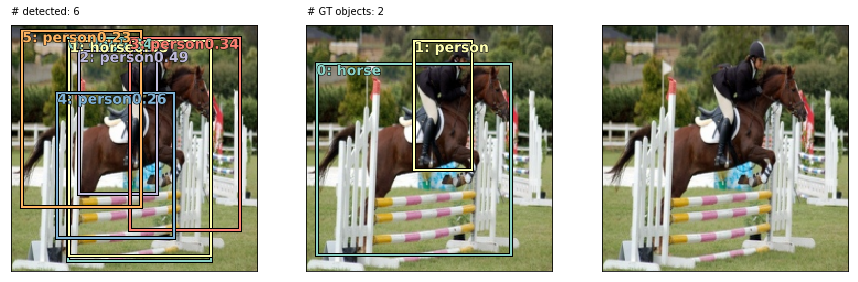

TP FP FN GTc   Category
0  1  0  0      dog (cat11)
1  0  0  1      horse (cat12)
0  4  1  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


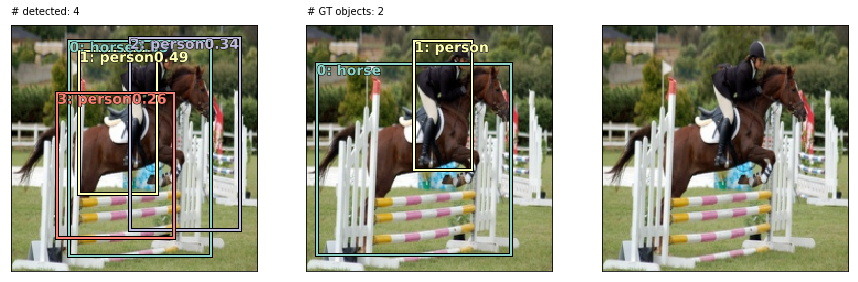

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
0  3  1  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


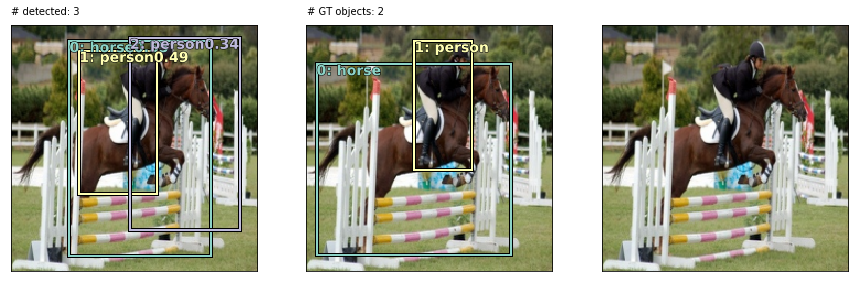

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
0  2  1  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


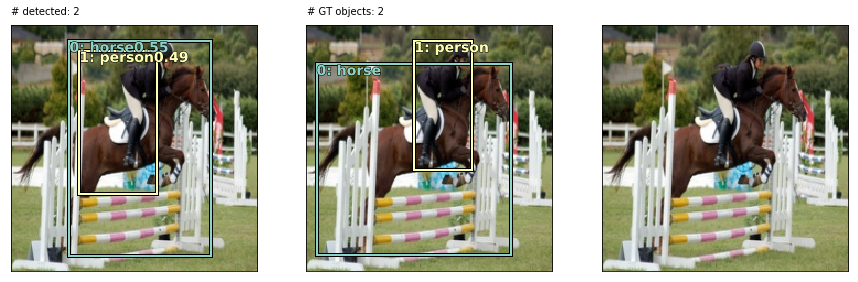

TP FP FN GTc   Category
1  0  0  1      horse (cat12)
0  1  1  1      person (cat14)


In [479]:
search_cat=12
found_objs = find_allgt_cat(search_cat)
found_objs[:5]

for i in range(3):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)


NMS CONFIDENCE THRESHOLD: 0.10


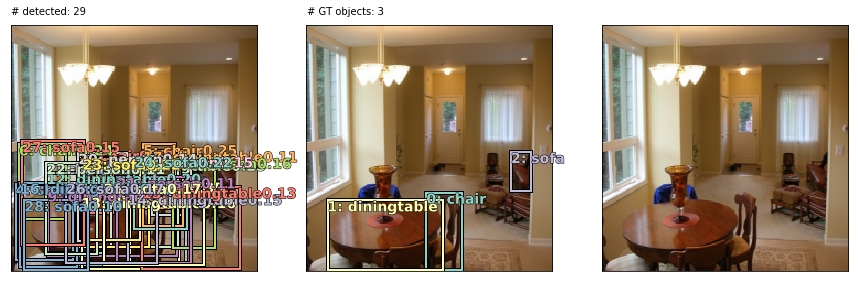

TP FP FN GTc   Category
1  8  0  1      chair (cat8)
1  8  0  1      diningtable (cat10)
0  5  0  0      person (cat14)
0  6  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.15


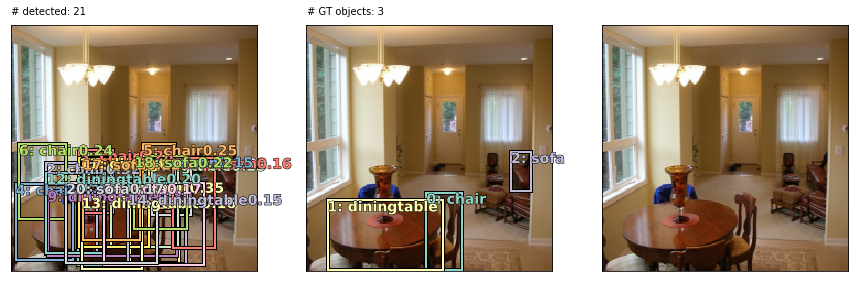

TP FP FN GTc   Category
1  8  0  1      chair (cat8)
1  5  0  1      diningtable (cat10)
0  2  0  0      person (cat14)
0  4  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.20


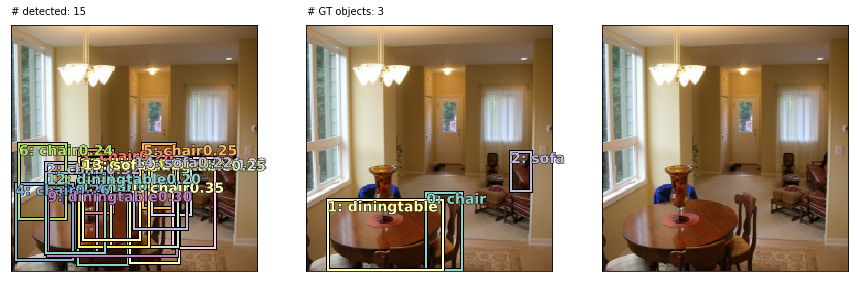

TP FP FN GTc   Category
1  8  0  1      chair (cat8)
1  3  0  1      diningtable (cat10)
0  2  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.25


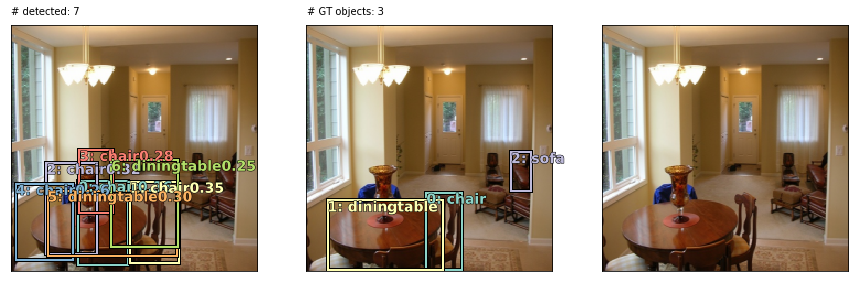

TP FP FN GTc   Category
1  4  0  1      chair (cat8)
1  1  0  1      diningtable (cat10)
0  0  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.30


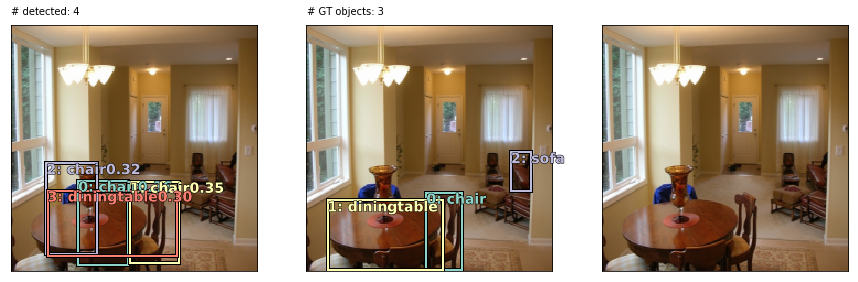

TP FP FN GTc   Category
1  2  0  1      chair (cat8)
1  0  0  1      diningtable (cat10)
0  0  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.35


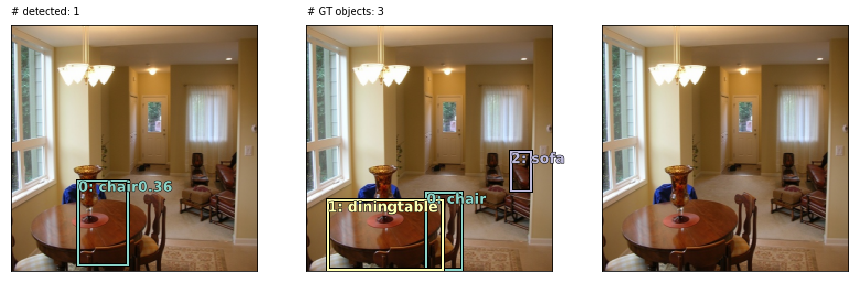

TP FP FN GTc   Category
0  1  1  1      chair (cat8)
0  0  1  1      diningtable (cat10)
0  0  1  1      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.10


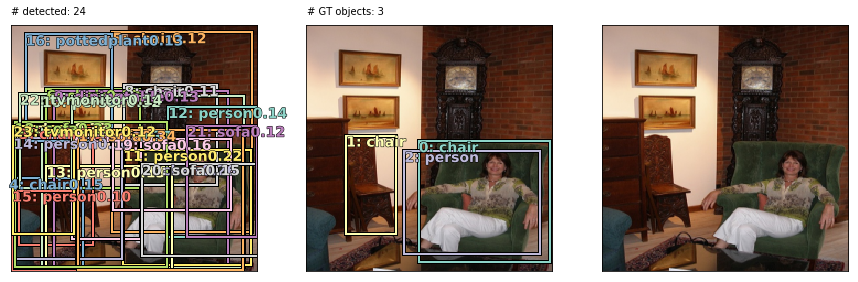

TP FP FN GTc   Category
1  8  1  2      chair (cat8)
0  1  0  0      diningtable (cat10)
1  5  0  1      person (cat14)
0  1  0  0      pottedplant (cat15)
0  5  0  0      sofa (cat17)
0  2  0  0      tvmonitor (cat19)

NMS CONFIDENCE THRESHOLD: 0.15


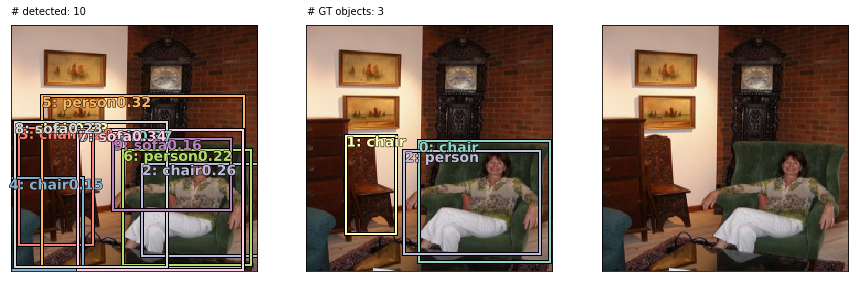

TP FP FN GTc   Category
1  4  1  2      chair (cat8)
1  1  0  1      person (cat14)
0  3  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.20


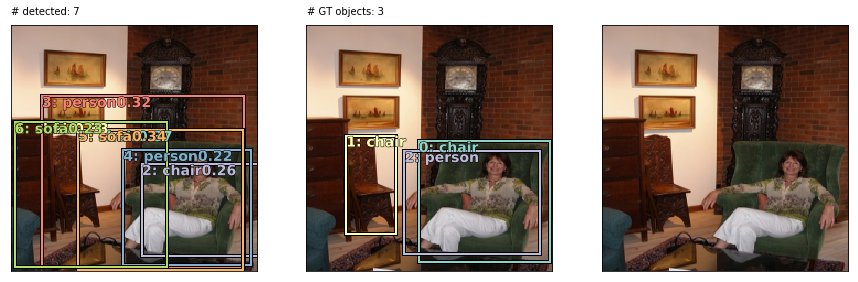

TP FP FN GTc   Category
1  2  1  2      chair (cat8)
1  1  0  1      person (cat14)
0  2  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.25


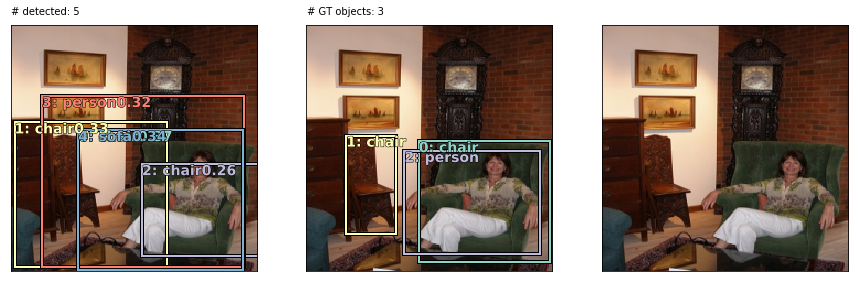

TP FP FN GTc   Category
1  2  1  2      chair (cat8)
0  1  1  1      person (cat14)
0  1  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.30


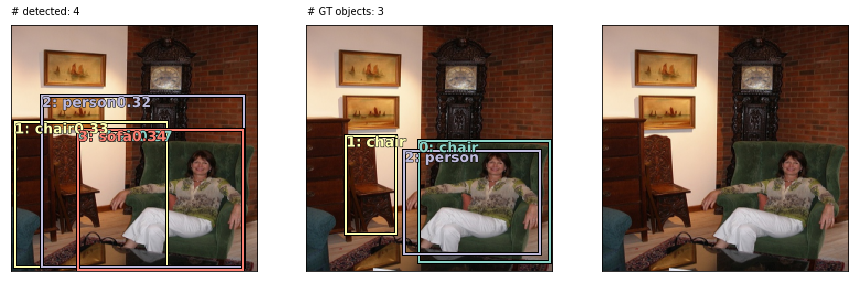

TP FP FN GTc   Category
1  1  1  2      chair (cat8)
0  1  1  1      person (cat14)
0  1  0  0      sofa (cat17)

NMS CONFIDENCE THRESHOLD: 0.35


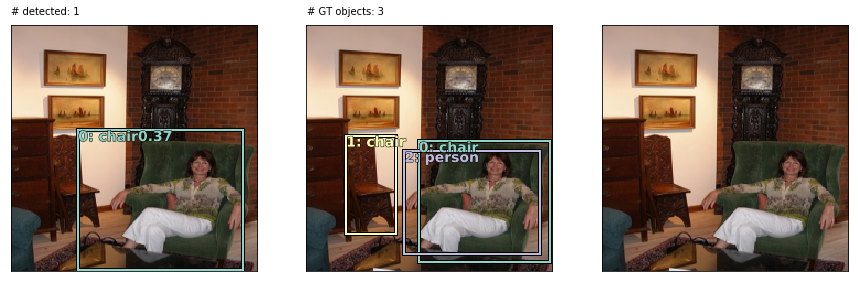

TP FP FN GTc   Category
1  0  1  2      chair (cat8)
0  0  1  1      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.10


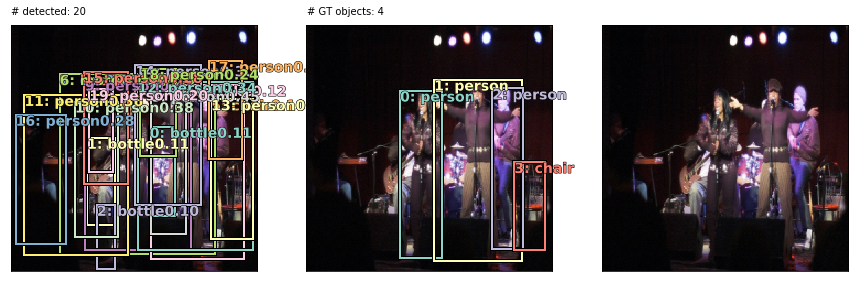

TP FP FN GTc   Category
0  3  0  0      bottle (cat4)
0  1  0  0      bus (cat5)
0  1  0  0      car (cat6)
0  1  1  1      chair (cat8)
0  2  0  0      motorbike (cat13)
1  11  2  3      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.15


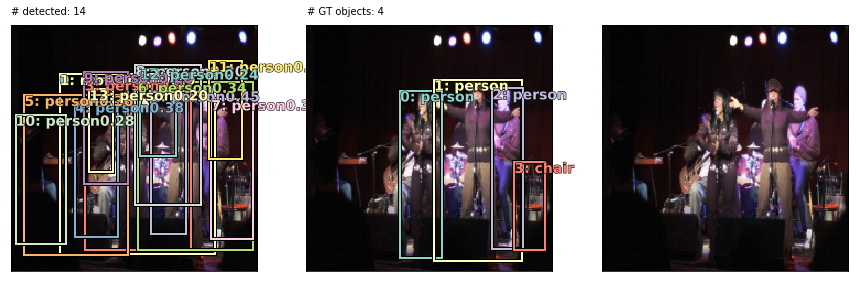

TP FP FN GTc   Category
0  1  0  0      car (cat6)
0  0  1  1      chair (cat8)
0  1  0  0      motorbike (cat13)
1  11  2  3      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.20


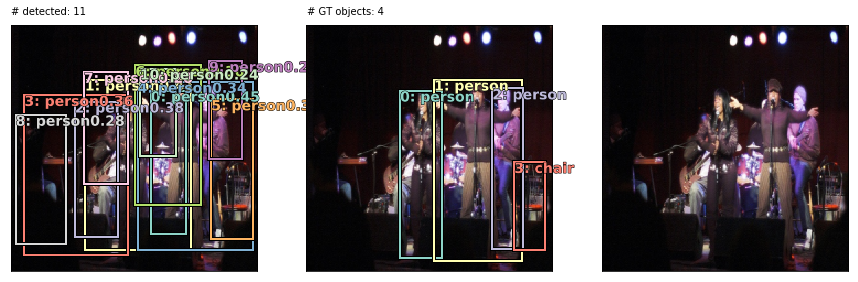

TP FP FN GTc   Category
0  0  1  1      chair (cat8)
1  10  2  3      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.25


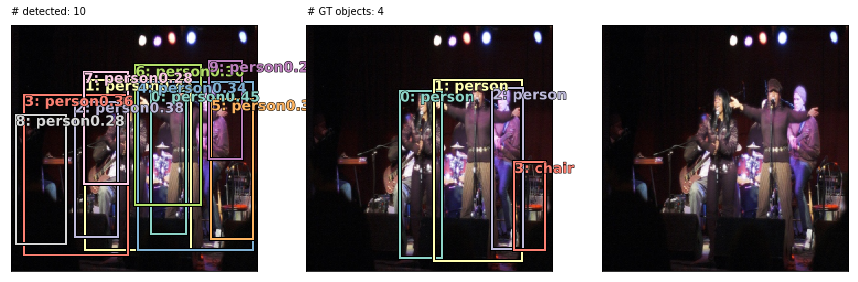

TP FP FN GTc   Category
0  0  1  1      chair (cat8)
1  9  2  3      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.30


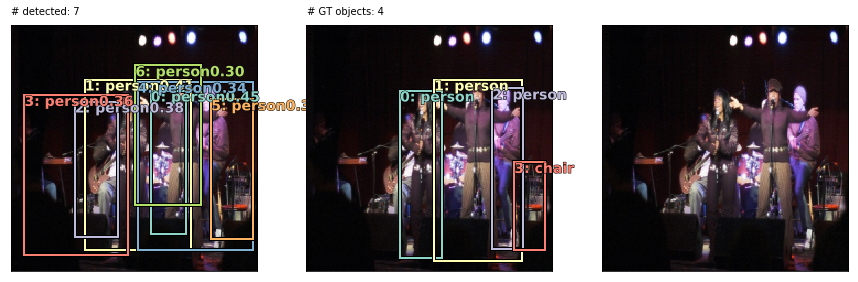

TP FP FN GTc   Category
0  0  1  1      chair (cat8)
1  6  2  3      person (cat14)

NMS CONFIDENCE THRESHOLD: 0.35


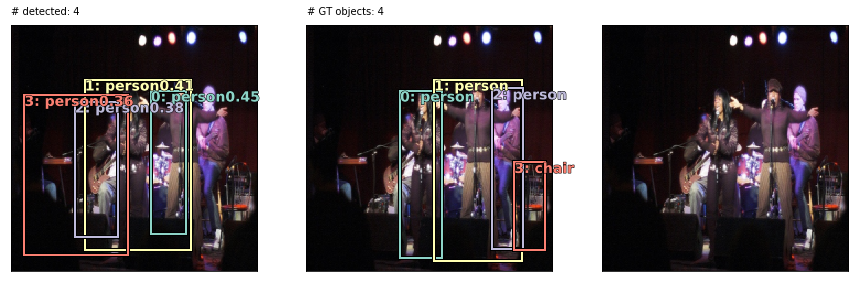

TP FP FN GTc   Category
0  0  1  1      chair (cat8)
0  4  3  3      person (cat14)


In [480]:
search_cat=8
found_objs = find_allgt_cat(search_cat)
found_objs[:5]

for i in range(3):
    b_num = found_objs[i][0]
    idx = found_objs[i][1]
    show_foundobjs_threshrange(b_num, idx, threshrange, verbose=True)